In [1]:
import os

root_dir = r"/gpfs/home/pl2948/CV/Project"
os.makedirs(root_dir, exist_ok=True)

# Configuration

In [2]:
import os
import pandas as pd
import torch

csv_path = os.path.join(root_dir, "data", "metadata_2D.csv") 
metadata_2D_df = pd.read_csv(csv_path)

NUM_CLASSES_DETAILED = 12 # Detailed (12類): 0:BG, 1:SA, 2:RF, 3:VL, 4:VI, 5:VM, 6:AM, 7:GR, 8:BFL, 9:ST, 10:SM, 11:BFS
NUM_CLASSES_ROUGH = 5 # Rough (5類): 0:BG, 1:SA, 2:QF, 3:GR, 4:HS
TARGET_SIZE = (256, 256)
BATCH_SIZE = 16 #32
ROUGH_LOSS_WEIGHT = 0.5
ORTHO_COUNDRY_WEIGHT = 2.0
LEARNING_RATE = 1e-4
NUM_EPOCHS = 50
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

print(f"資料總筆數: {len(metadata_2D_df)}")
print(f"Columns: {metadata_2D_df.columns.tolist()}")

資料總筆數: 13619
Columns: ['Dataset', 'MRI sample', 'Phenotype', 'Ethnicity', 'Gender', 'Age', 'MRI Sequence', 'Slice', 'image_2D_file', 'rough_label_2D_file', 'detailed_label_2D_file', 'split']


# Train - validation split

In [3]:
import pandas as pd
from sklearn.model_selection import train_test_split

# 篩選出 Training Set
train_df = metadata_2D_df[metadata_2D_df['split'] == 'train'].copy()
has_detailed = train_df['detailed_label_2D_file'].notna()

train_detailed_df = train_df[has_detailed]
train_rough_only_df = train_df[~has_detailed]

print(f"原始 Train 總數: {len(train_df)}")
print(f"  - 有 Detailed Label: {len(train_detailed_df)}")
print(f"  - 只有 Rough Label: {len(train_rough_only_df)}")

# 從有 Detailed Label 的資料中，分層切分 Validation Set
train_det_subset, val_subset = train_test_split(
    train_detailed_df,
    test_size=0.1,  # 10% 用作驗證
    stratify=train_detailed_df['MRI Sequence'],
    random_state=42
)

final_train_df = pd.concat([train_rough_only_df, train_det_subset])

test_df = metadata_2D_df[metadata_2D_df['split'] == 'test'].copy()

print("-" * 30)
print(f"最終 Training Set: {len(final_train_df)} (混合 Rough + Detailed)")
print(f"最終 Validation Set: {len(val_subset)} (全為 Detailed)")
print(f"Test Set: {len(test_df)}")
print("-" * 30)
print("Validation Set 的 Sequence 分佈:")
print(val_subset['MRI Sequence'].value_counts())

原始 Train 總數: 12564
  - 有 Detailed Label: 5400
  - 只有 Rough Label: 7164
------------------------------
最終 Training Set: 12024 (混合 Rough + Detailed)
最終 Validation Set: 540 (全為 Detailed)
Test Set: 1055
------------------------------
Validation Set 的 Sequence 分佈:
MRI Sequence
T1       168
Fat      154
Water     78
T2        77
STIR      63
Name: count, dtype: int64


# Dataset

In [4]:
import torch
import torch.nn.functional as F
from torch.utils.data import Dataset
import SimpleITK as sitk
import numpy as np
import os
import pandas as pd

class MuscleTwoHeadDataset(Dataset):
    def __init__(self, dataframe, root_dir, target_size=(256, 256), transform=None):
        self.df = dataframe.reset_index(drop=True)
        self.root_dir = os.path.join(root_dir, "data")
        self.target_size = target_size
        self.transform = transform

    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        row = self.df.iloc[idx]
        
        # --- 1. 讀取與處理影像 (Image) ---
        img_path = os.path.join(self.root_dir, row['image_2D_file'])
        image_obj = sitk.ReadImage(img_path)
        image_np = sitk.GetArrayFromImage(image_obj).astype(np.float32)
        
        # 確保維度 (1, H, W)
        img_t = torch.from_numpy(image_np)
        if img_t.ndim == 2: img_t = img_t.unsqueeze(0)
        
        # Normalize
        if img_t.max() > 0: img_t = img_t / img_t.max()

        # Resize Image
        img_t = F.interpolate(img_t.unsqueeze(0), size=self.target_size, mode='bilinear', align_corners=False).squeeze(0)

        # --- 2. 讀取 Label (邏輯：優先使用 Detailed) ---
        label_np = None
        label_type = 0 # 1: Detailed, 0: Rough
        
        # 檢查是否有 Detailed Label
        if pd.notna(row['detailed_label_2D_file']):
            det_path = os.path.join(self.root_dir, row['detailed_label_2D_file'])
            if os.path.exists(det_path):
                lbl_obj = sitk.ReadImage(det_path)
                label_np = sitk.GetArrayFromImage(lbl_obj).astype(np.int64)
                label_type = 1 # 標記為 Detailed
        
        # 如果沒有 Detailed，才去讀 Rough
        if label_np is None:
            rough_path = os.path.join(self.root_dir, row['rough_label_2D_file'])
            if os.path.exists(rough_path):
                lbl_obj = sitk.ReadImage(rough_path)
                label_np = sitk.GetArrayFromImage(lbl_obj).astype(np.int64)
                label_type = 0 # 標記為 Rough
            else:
                # 如果都沒有，給全黑
                label_np = np.zeros(self.target_size, dtype=np.int64)
                label_type = -1

        # --- 3. 處理 Label Resize ---
        lbl_t = torch.from_numpy(label_np).float() # 先轉 float 才能 interpolate
        
        # 確保維度 (1, 1, H, W)
        if lbl_t.ndim == 2: lbl_t = lbl_t.view(1, 1, lbl_t.shape[0], lbl_t.shape[1])
        elif lbl_t.ndim == 3: lbl_t = lbl_t.unsqueeze(0)

        # Resize Label (Nearest Neighbor)
        lbl_t = F.interpolate(lbl_t, size=self.target_size, mode='nearest')
        lbl_t = lbl_t.squeeze().long() # 轉回 Long Tensor (H, W)

        return img_t, lbl_t, label_type, row['MRI sample']

In [5]:
from torch.utils.data import DataLoader

train_ds = MuscleTwoHeadDataset(final_train_df, root_dir, target_size=TARGET_SIZE)
val_ds = MuscleTwoHeadDataset(val_subset, root_dir, target_size=TARGET_SIZE)

train_loader = DataLoader(train_ds, batch_size=BATCH_SIZE, shuffle=True, num_workers=4)
val_loader = DataLoader(val_ds, batch_size=1, shuffle=False, num_workers=2)

print("DataLoader 準備完成")

DataLoader 準備完成


In [6]:
# import torch
# import numpy as np
# import matplotlib.pyplot as plt
# from tqdm import tqdm

# # 1. 檢查單個 Batch (視覺化確認)
# print("--- 檢查單個 Batch ---")
# data_iter = iter(train_loader)
# try:
#     images, labels, types, sample_ids = next(data_iter)

#     print(f"Images shape: {images.shape}")  # 預期: (Batch_Size, 1, H, W)
#     print(f"Labels shape: {labels.shape}")  # 預期: (Batch_Size, H, W)
#     print(f"Types shape:  {types.shape}")   # 預期: (Batch_Size,)
#     print(f"Types values: {types}")         # 應包含 0 (Rough) 或 1 (Detailed)
#     print(f"Sample IDs:   {sample_ids}")    # 檔名或樣本ID

#     # 視覺化第一張圖
#     idx = 0
#     img_show = images[idx, 0].numpy()
#     lbl_show = labels[idx].numpy()
#     type_show = "Detailed" if types[idx] == 1 else "Rough"
    
#     is_empty = (lbl_show.max() == 0)
#     title_suffix = " (EMPTY LABEL!)" if is_empty else ""

#     plt.figure(figsize=(12, 5))
    
#     plt.subplot(1, 2, 1)
#     plt.imshow(img_show, cmap='gray')
#     plt.title(f"Image (Type: {type_show})\nID: {sample_ids[idx]}")
#     plt.axis('off')

#     plt.subplot(1, 2, 2)
#     plt.imshow(img_show, cmap='gray')
#     plt.imshow(lbl_show, cmap='jet', alpha=0.5)
#     plt.title(f"Label Overlay{title_suffix}\nUnique vals: {np.unique(lbl_show)}")
#     plt.axis('off')

#     plt.show()

# except Exception as e:
#     print(f"讀取 Batch 失敗: {e}")


# # 2. 完整掃描與統計 (包含 Train 與 Val)
# def scan_loader(loader, loader_name):
#     print(f"\n正在掃描 {loader_name} ...")
    
#     total_samples = 0
#     empty_count = 0
#     empty_samples = [] # 儲存全黑樣本的資訊

#     try:
#         for batch_idx, (images, labels, types, sample_ids) in enumerate(tqdm(loader)):
            
#             # 遍歷 Batch 中的每一張圖
#             batch_size = labels.shape[0]
#             total_samples += batch_size
            
#             for i in range(batch_size):
#                 # 判斷該張 Label 是否最大值為 0 (即全黑)
#                 if labels[i].max() == 0:
#                     empty_count += 1
#                     # 記錄下來 (只記前 10 筆以免刷屏，或者是全部存起來最後看)
#                     if len(empty_samples) < 20: 
#                         type_str = "Detailed" if types[i] == 1 else "Rough"
#                         empty_samples.append(f"{sample_ids[i]} ({type_str})")

#         print(f">> {loader_name} 掃描完成！")
#         print(f"   總樣本數: {total_samples}")
#         print(f"   全黑 Label 數: {empty_count} ({empty_count/total_samples*100:.2f}%)")
        
#         if empty_count > 0:
#             print("   部分全黑樣本 ID 範例:")
#             for s in empty_samples:
#                 print(f"     - {s}")
#             if empty_count > 20:
#                 print(f"     ... 以及其他 {empty_count - 20} 張")
#         else:
#             print("   沒有發現全黑的 Label。")

#     except Exception as e:
#         print(f"\n!! 錯誤：在 Batch {batch_idx} 發生錯誤 !!")
#         print(f"錯誤訊息: {e}")

# scan_loader(train_loader, "Train Loader")
# scan_loader(val_loader, "Val Loader")

# Model

In [6]:
import torch.nn as nn
import torch.nn.functional as F

class DoubleConv(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.double_conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        return self.double_conv(x)

class TwoHeadUNet(nn.Module):
    def __init__(self, n_channels, n_classes_detailed, n_classes_rough):
        super(TwoHeadUNet, self).__init__()
        self.inc = DoubleConv(n_channels, 64)
        self.down1 = nn.Sequential(nn.MaxPool2d(2), DoubleConv(64, 128))
        self.down2 = nn.Sequential(nn.MaxPool2d(2), DoubleConv(128, 256))
        self.down3 = nn.Sequential(nn.MaxPool2d(2), DoubleConv(256, 512))
        self.down4 = nn.Sequential(nn.MaxPool2d(2), DoubleConv(512, 1024))
        
        self.up1 = nn.ConvTranspose2d(1024, 512, kernel_size=2, stride=2)
        self.conv1 = DoubleConv(1024, 512)
        self.up2 = nn.ConvTranspose2d(512, 256, kernel_size=2, stride=2)
        self.conv2 = DoubleConv(512, 256)
        self.up3 = nn.ConvTranspose2d(256, 128, kernel_size=2, stride=2)
        self.conv3 = DoubleConv(256, 128)
        self.up4 = nn.ConvTranspose2d(128, 64, kernel_size=2, stride=2)
        self.conv4 = DoubleConv(128, 64)
        
        # === 兩個 Output Heads ===
        # Head 1: 負責 Detailed Label (12類)
        self.head_detailed = nn.Conv2d(64, n_classes_detailed, kernel_size=1)
        
        # Head 2: 負責 Rough Label (5類)
        self.head_rough = nn.Conv2d(64, n_classes_rough, kernel_size=1)

    def forward(self, x):
        x1 = self.inc(x)
        x2 = self.down1(x1)
        x3 = self.down2(x2)
        x4 = self.down3(x3)
        x5 = self.down4(x4)
        
        x = self.up1(x5)
        if x.shape != x4.shape: x = F.interpolate(x, size=x4.shape[2:], mode='bilinear', align_corners=True)
        x = torch.cat([x4, x], dim=1)
        x = self.conv1(x)
        
        x = self.up2(x)
        if x.shape != x3.shape: x = F.interpolate(x, size=x3.shape[2:], mode='bilinear', align_corners=True)
        x = torch.cat([x3, x], dim=1)
        x = self.conv2(x)
        
        x = self.up3(x)
        if x.shape != x2.shape: x = F.interpolate(x, size=x2.shape[2:], mode='bilinear', align_corners=True)
        x = torch.cat([x2, x], dim=1)
        x = self.conv3(x)
        
        x = self.up4(x)
        if x.shape != x1.shape: x = F.interpolate(x, size=x1.shape[2:], mode='bilinear', align_corners=True)
        x = torch.cat([x1, x], dim=1)
        x = self.conv4(x)
        
        # 輸出兩個結果
        out_detailed = self.head_detailed(x)
        out_rough = self.head_rough(x)
        
        return out_detailed, out_rough

model = TwoHeadUNet(n_channels=1, 
                    n_classes_detailed=NUM_CLASSES_DETAILED, # 12
                    n_classes_rough=NUM_CLASSES_ROUGH)       # 5
model = model.to(DEVICE)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)

In [7]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class OrthogonalBoundaryLoss(nn.Module):
    def __init__(self):
        super(OrthogonalBoundaryLoss, self).__init__()

    def forward(self, logits, targets):
        """
        論文核心概念：強制不同類別在邊界處的特徵向量正交 (Cosine Sim -> 0)
        Args:
            logits: 模型輸出 (B, Num_Classes, H, W)，尚未經過 softmax 的特徵
            targets: Ground Truth 標籤 (B, H, W)
        """
        # 1. 準備數據
        b, c, h, w = logits.shape
        
        # 將 targets 轉為 One-hot 編碼，方便後續比對類別
        # shape: (B, Num_Classes, H, W)
        target_one_hot = F.one_hot(targets, num_classes=c).permute(0, 3, 1, 2).float()
        
        # 2. 利用 unfold 提取每個像素的 3x3 鄰居 (Vectorized Neighbor Search)
        # 這是為了取代論文中慢速的 Graph 建構與採樣過程
        
        # 提取特徵圖的鄰居
        # patches shape: (B, C, 9, H, W) -> 每個像素都有 9 個鄰居的特徵向量
        feature_patches = F.unfold(logits, 3, padding=1).view(b, c, 9, h, w)
        
        # 提取 Label 的鄰居
        # target_patches shape: (B, C, 9, H, W)
        target_patches = F.unfold(target_one_hot, 3, padding=1).view(b, c, 9, h, w)
        
        # 準備中心點數據 (unsqueeze 讓維度對齊)
        center_feat = logits.unsqueeze(2)       # (B, C, 1, H, W)
        center_target = target_one_hot.unsqueeze(2) # (B, C, 1, H, W)
        
        # 3. 計算特徵相似度 (Cosine Similarity)
        # 對應論文公式 (11): cos(F_i, F_j)
        # Normalize 向量長度為 1
        center_norm = F.normalize(center_feat, dim=1)
        neighbor_norm = F.normalize(feature_patches, dim=1)
        
        # 計算 Cosine Similarity (內積)
        cosine_sim = (center_norm * neighbor_norm).sum(dim=1) # (B, 9, H, W)
        
        # 4. 篩選邊界 (Masking)
        # 論文觀念：只針對 "adjacent cell pairs" (相鄰但不同 ID 的像素) 進行約束
        
        # 檢查鄰居類別是否與中心點相同？ (Dot product)
        # 相同=1, 不同=0
        is_same_class = (center_target * target_patches).sum(dim=1) # (B, 9, H, W)
        
        # 製作 Mask：我們只關心「類別不同」的鄰居 (is_same_class == 0)
        boundary_mask = (is_same_class == 0).float()
        
        # 5. 計算 Loss
        # 目標：最小化邊界處不同類別的相似度 (讓 cosine_sim 趨近 0)
        # 加總所有邊界像素的絕對相似度
        loss = (torch.abs(cosine_sim) * boundary_mask).sum() / (boundary_mask.sum() + 1e-6)
        
        return loss

In [8]:
import torch
import torch.nn as nn
import torch.nn.functional as F

# 加入使用orthogonal boundry loss

class DualTaskLoss(nn.Module):
    def __init__(self, rough_weight=0.5, ortho_weight=1.0):
        """
        rough_weight: 控制 Rough Task 的總權重 (包含 CE 和 Ortho)
        ortho_weight: 控制 Orthogonal Boundary Loss 相對於 CE Loss 的權重
                      (建議 0.5 ~ 2.0，視邊界黏連情況調整)
        """
        super().__init__()
        self.ce = nn.CrossEntropyLoss()
        self.ortho_loss_fn = OrthogonalBoundaryLoss() # 初始化我們剛寫好的 Loss
        
        self.rough_weight = rough_weight
        self.ortho_weight = ortho_weight
        
    def forward(self, pred_detailed, pred_rough, targets, types):
        """
        pred_detailed: (B, 12, H, W)
        pred_rough:    (B, 5, H, W)
        targets:       (B, H, W)
        types:         (B) - 1: Detailed, 0: Rough
        """
        total_loss = 0.0
        
        # === 1. 計算 Detailed Loss (只針對 types == 1) ===
        det_mask = (types == 1)
        if det_mask.any():
            # 取出 Detailed 的數據
            p_det = pred_detailed[det_mask]
            t_det = targets[det_mask]
            
            # A. 基礎分割損失 (CrossEntropy)
            loss_det_ce = self.ce(p_det, t_det)
            
            # B. 邊界正交損失 (Orthogonal Boundary)
            # 這會強迫 12 塊肌肉之間的邊界更清晰
            loss_det_ortho = self.ortho_loss_fn(p_det, t_det)
            
            # 結合 (CE + weight * Ortho)
            total_loss += loss_det_ce + (self.ortho_weight * loss_det_ortho)
            
        # === 2. 計算 Rough Loss (只針對 types == 0) ===
        rough_mask = (types == 0)
        if rough_mask.any():
            # 取出 Rough 的數據
            p_rough = pred_rough[rough_mask]
            t_rough = targets[rough_mask]
            
            # A. 基礎分割損失 (CrossEntropy)
            loss_rough_ce = self.ce(p_rough, t_rough)
            
            # B. 邊界正交損失 (Orthogonal Boundary)
            # 這會強迫 5 大肌肉群之間的邊界更清晰
            loss_rough_ortho = self.ortho_loss_fn(p_rough, t_rough)
            
            # 結合，並乘上 rough_weight
            # 注意：這裡 rough_weight 同時降低了 CE 和 Ortho 的影響力，這是合理的
            term_rough = loss_rough_ce + (self.ortho_weight * loss_rough_ortho)
            total_loss += term_rough * self.rough_weight
            
        return total_loss

criterion = DualTaskLoss(rough_weight=ROUGH_LOSS_WEIGHT, ortho_weight=ORTHO_COUNDRY_WEIGHT)

# Training

In [ ]:
from torch.utils.data import DataLoader
from tqdm import tqdm

best_val_dice = 0.0

train_loss_list = []
avg_val_dice_list = []

for epoch in range(NUM_EPOCHS):
    model.train()
    train_loss = 0
    
    pbar = tqdm(train_loader, desc=f"Epoch {epoch+1}/{NUM_EPOCHS}")
    for images, labels, types, _ in pbar:
        images, labels, types = images.to(DEVICE), labels.to(DEVICE), types.to(DEVICE)
        
        optimizer.zero_grad()
        
        # Model 輸出兩個結果
        out_det, out_rough = model(images)
        
        # Loss 自動判斷要用哪一個
        loss = criterion(out_det, out_rough, labels, types)
        
        loss.backward()
        optimizer.step()
        
        train_loss += loss.item()
        pbar.set_postfix({'loss': loss.item()})
        
    # --- Validation (只看 Detailed Head 的表現) ---
    model.eval()
    val_dice_sum = 0
    
    with torch.no_grad():
        for images, labels, types, _ in val_loader:
            # Validation 全是 Detailed data
            images, labels = images.to(DEVICE), labels.to(DEVICE)
            out_det, _ = model(images)
            preds = torch.argmax(out_det, dim=1)
            
            # 計算 Dice
            curr_dice = 0
            for c in range(1, NUM_CLASSES_DETAILED):
                inter = ((preds == c) & (labels == c)).sum().item()
                union = ((preds == c).sum() + (labels == c).sum()).item()
                if union > 0: curr_dice += 2 * inter / union
                elif union == 0: curr_dice += 1.0
            
            val_dice_sum += curr_dice / (NUM_CLASSES_DETAILED - 1)
            
    avg_val_dice = val_dice_sum / len(val_loader)
    print(f"Epoch {epoch+1} | Train Loss: {train_loss/len(train_loader):.4f} | Val Dice: {avg_val_dice:.4f}")
    train_loss_list.append(train_loss/len(train_loader))
    avg_val_dice_list.append(avg_val_dice)
    
    if avg_val_dice > best_val_dice:
        best_val_dice = avg_val_dice
        torch.save(model.state_dict(), os.path.join(root_dir, "best_orthogonal_model.pth"))
        print("New Best Model Saved")
        
torch.save(model.state_dict(), os.path.join(root_dir, "last_orthogonal_model.pth"))
print("Last Model Saved")

Epoch 1/50: 100%|██████████| 752/752 [04:32<00:00,  2.76it/s, loss=0.398]


Epoch 1 | Train Loss: 1.1081 | Val Dice: 0.1870
New Best Model Saved


Epoch 2/50: 100%|██████████| 752/752 [03:38<00:00,  3.44it/s, loss=0.42] 


Epoch 2 | Train Loss: 0.5219 | Val Dice: 0.1881
New Best Model Saved


Epoch 3/50: 100%|██████████| 752/752 [03:59<00:00,  3.14it/s, loss=0.441]


Epoch 3 | Train Loss: 0.4105 | Val Dice: 0.1889
New Best Model Saved


Epoch 4/50: 100%|██████████| 752/752 [03:30<00:00,  3.57it/s, loss=0.527]


Epoch 4 | Train Loss: 0.3743 | Val Dice: 0.2028
New Best Model Saved


Epoch 5/50: 100%|██████████| 752/752 [03:35<00:00,  3.50it/s, loss=0.285]


Epoch 5 | Train Loss: 0.3423 | Val Dice: 0.2374
New Best Model Saved


Epoch 6/50: 100%|██████████| 752/752 [03:27<00:00,  3.63it/s, loss=0.501]


Epoch 6 | Train Loss: 0.3106 | Val Dice: 0.2442
New Best Model Saved


Epoch 7/50: 100%|██████████| 752/752 [03:27<00:00,  3.63it/s, loss=0.235]


Epoch 7 | Train Loss: 0.2644 | Val Dice: 0.3194
New Best Model Saved


Epoch 8/50: 100%|██████████| 752/752 [03:35<00:00,  3.50it/s, loss=0.15] 


Epoch 8 | Train Loss: 0.2229 | Val Dice: 0.3922
New Best Model Saved


Epoch 9/50: 100%|██████████| 752/752 [03:32<00:00,  3.54it/s, loss=0.127]


Epoch 9 | Train Loss: 0.1900 | Val Dice: 0.4695
New Best Model Saved


Epoch 10/50: 100%|██████████| 752/752 [03:28<00:00,  3.61it/s, loss=0.179] 


Epoch 10 | Train Loss: 0.1583 | Val Dice: 0.6312
New Best Model Saved


Epoch 11/50: 100%|██████████| 752/752 [03:29<00:00,  3.59it/s, loss=0.142] 


Epoch 11 | Train Loss: 0.1360 | Val Dice: 0.7043
New Best Model Saved


Epoch 12/50: 100%|██████████| 752/752 [03:29<00:00,  3.60it/s, loss=0.0693]


Epoch 12 | Train Loss: 0.1044 | Val Dice: 0.7637
New Best Model Saved


Epoch 13/50: 100%|██████████| 752/752 [05:46<00:00,  2.17it/s, loss=0.0787]  


Epoch 13 | Train Loss: 0.0933 | Val Dice: 0.7866
New Best Model Saved


Epoch 14/50: 100%|██████████| 752/752 [03:31<00:00,  3.56it/s, loss=0.0785]


Epoch 14 | Train Loss: 0.0910 | Val Dice: 0.8103
New Best Model Saved


Epoch 15/50: 100%|██████████| 752/752 [03:31<00:00,  3.55it/s, loss=0.0863]


Epoch 15 | Train Loss: 0.0766 | Val Dice: 0.8216
New Best Model Saved


Epoch 16/50: 100%|██████████| 752/752 [03:25<00:00,  3.66it/s, loss=0.0645]


Epoch 16 | Train Loss: 0.0725 | Val Dice: 0.8159


Epoch 17/50: 100%|██████████| 752/752 [03:32<00:00,  3.54it/s, loss=0.0756]


Epoch 17 | Train Loss: 0.0723 | Val Dice: 0.8404
New Best Model Saved


Epoch 18/50: 100%|██████████| 752/752 [03:25<00:00,  3.65it/s, loss=0.0607]


Epoch 18 | Train Loss: 0.0639 | Val Dice: 0.8415
New Best Model Saved


Epoch 19/50: 100%|██████████| 752/752 [03:30<00:00,  3.57it/s, loss=0.0673]


Epoch 19 | Train Loss: 0.0603 | Val Dice: 0.8356


Epoch 20/50: 100%|██████████| 752/752 [03:28<00:00,  3.60it/s, loss=0.0568]


Epoch 20 | Train Loss: 0.0590 | Val Dice: 0.8548
New Best Model Saved


Epoch 21/50:  14%|█▎        | 102/752 [00:28<02:57,  3.66it/s, loss=0.0547]

# Test

測試集 (Detailed Only) 數量: 618
預計視覺化切片數: 93 (包含每個個案/序列的頭中尾)


100%|██████████| 618/618 [00:08<00:00, 72.64it/s]


   各 MRI Sequence 分肌肉 Dice 評估表
數值為 Mean Dice Score:


,Fat,STIR,T1,T2,Water
Adductor Magnus,0.7688,0.6971,0.8596,0.7847,0.7245
Biceps Femoris LH,0.7572,0.6800,0.8759,0.7636,0.7275
Biceps Femoris SH,0.7875,0.7608,0.8627,0.7566,0.7771
Gracilis,0.7679,0.6316,0.8189,0.7434,0.7150
Rectus Femoris,0.7739,0.6654,0.8424,0.7835,0.7971
Sartorius,0.8147,0.7222,0.8747,0.8050,0.7675
Semimembranosus,0.6946,0.7244,0.8374,0.7074,0.6588
Semitendinosus,0.7047,0.6972,0.8152,0.7017,0.6695
Vastus Intermedius,0.7438,0.7623,0.8711,0.7690,0.7599
Vastus Lateralis,0.7678,0.7875,0.8838,0.8074,0.7933



評估表已儲存至 evaluation_metrics_per_sequence.csv

   個案切片視覺化 (First / Middle / Last)

>>> Case: THIGH_005 | Modality: Fat


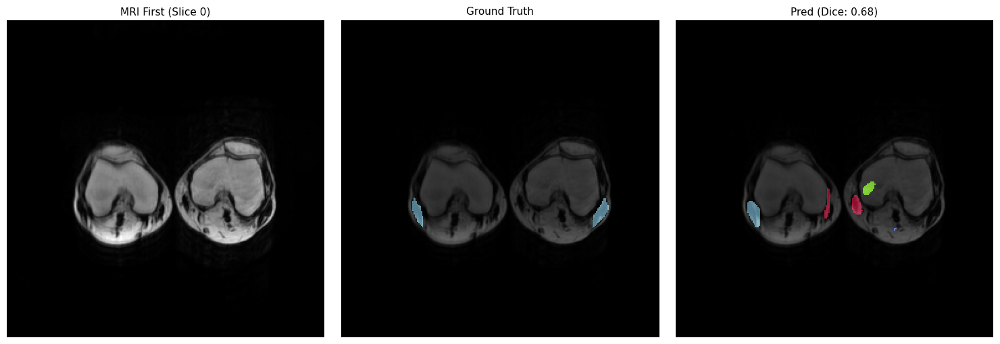

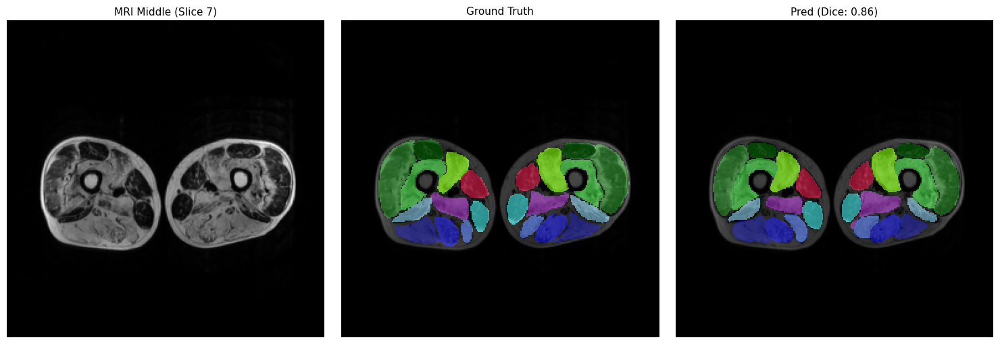

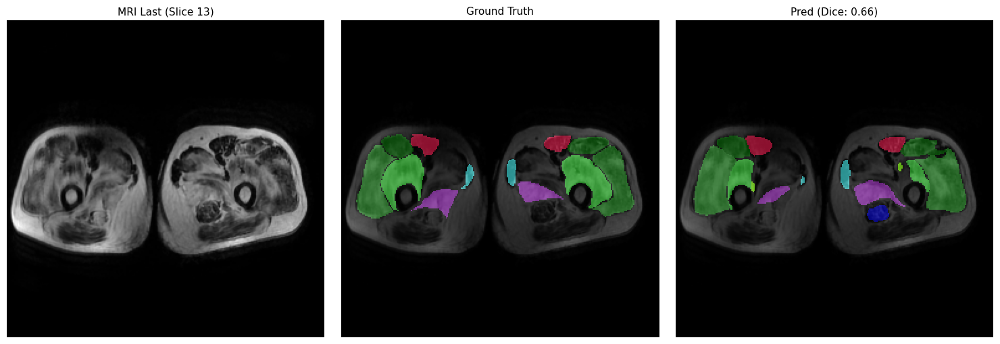


>>> Case: THIGH_005 | Modality: T1


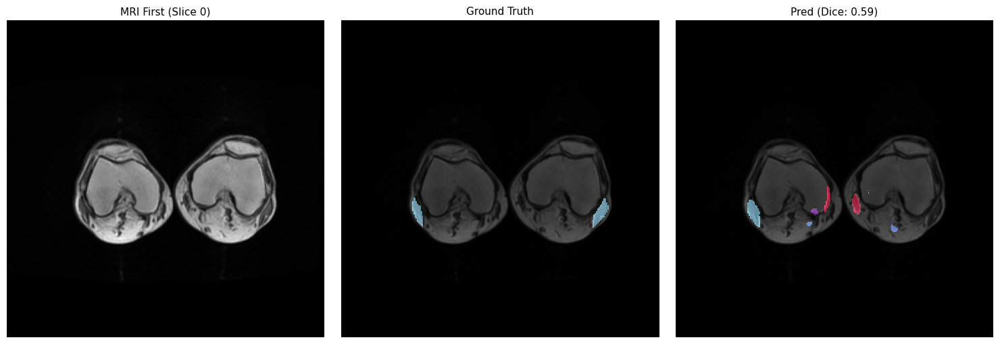

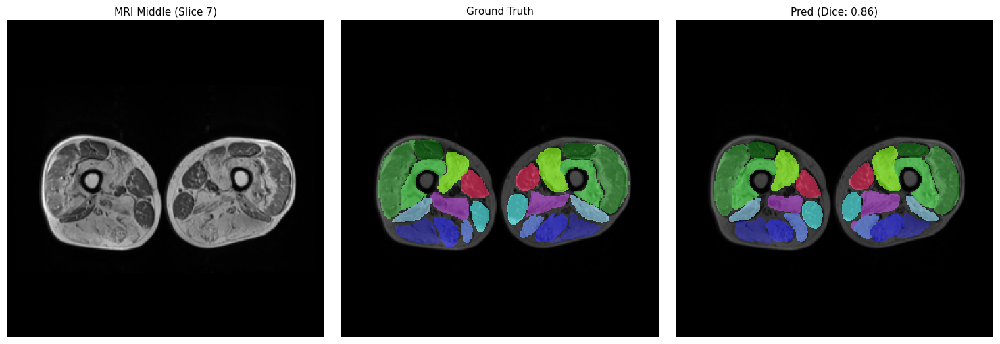

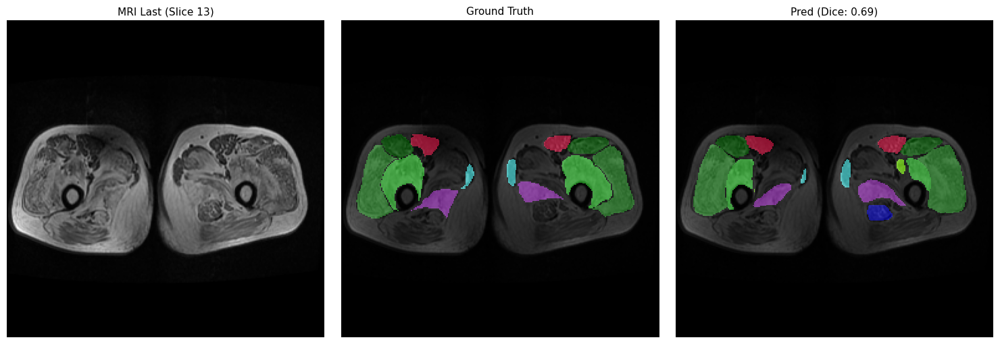


>>> Case: THIGH_005 | Modality: T2


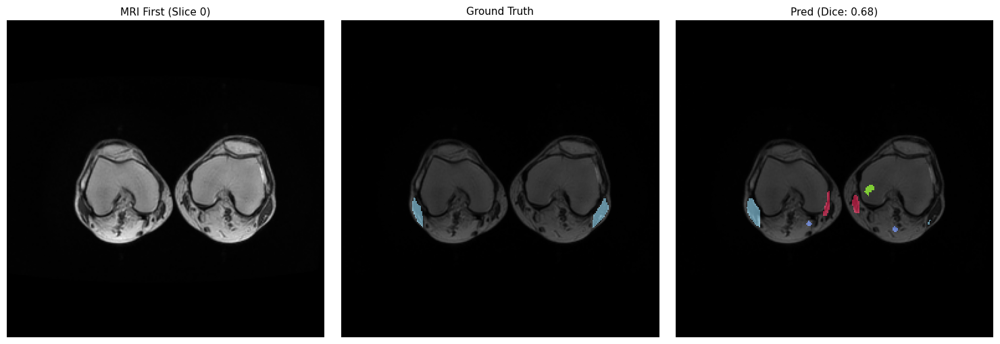

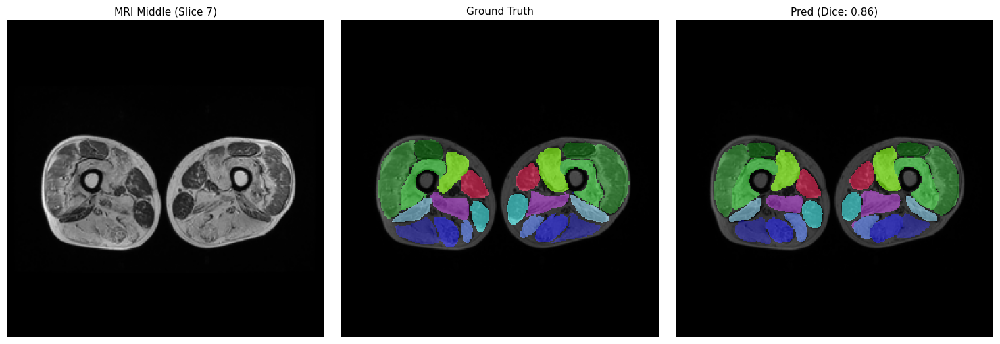

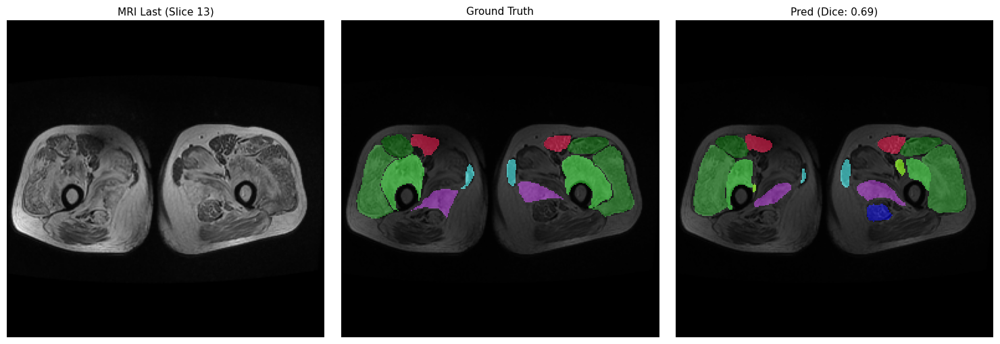


>>> Case: THIGH_005 | Modality: Water


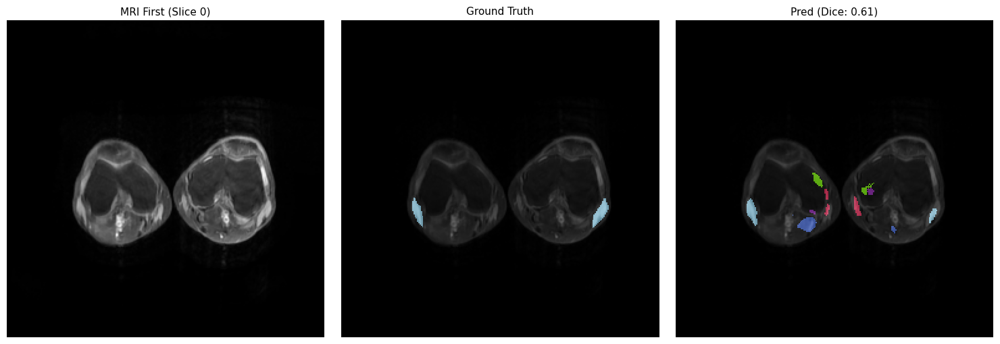

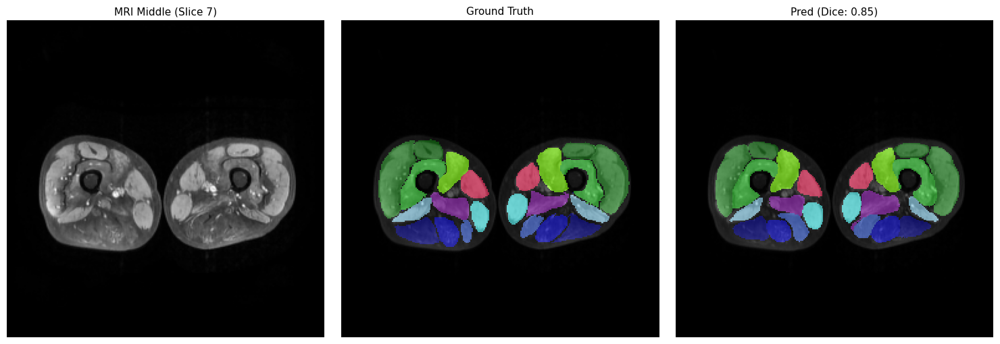

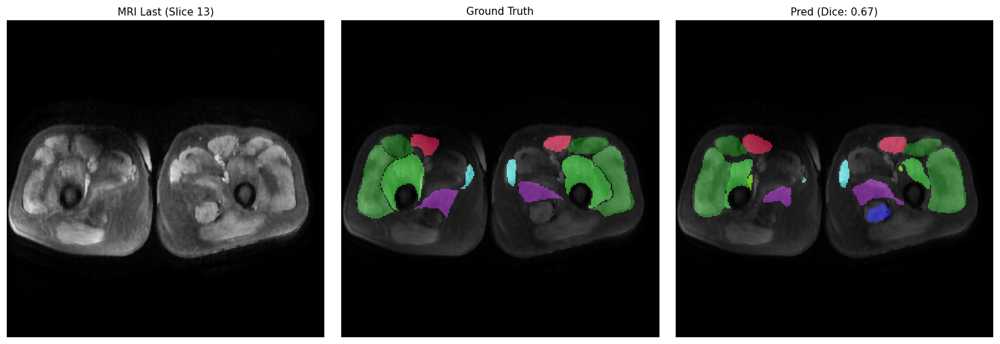


>>> Case: THIGH_011 | Modality: Fat


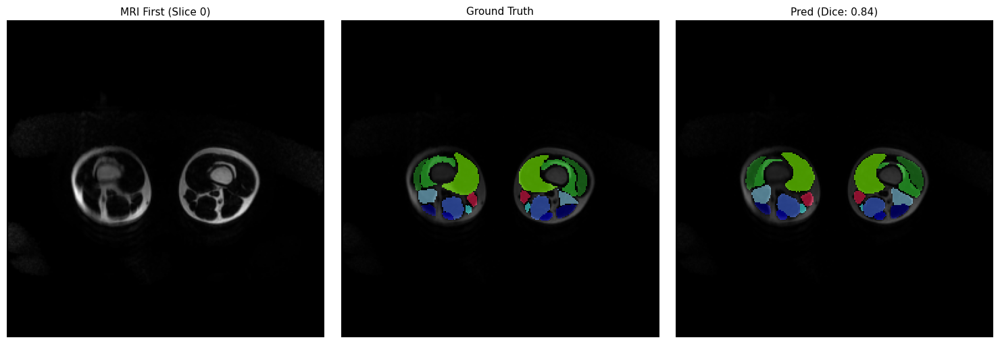

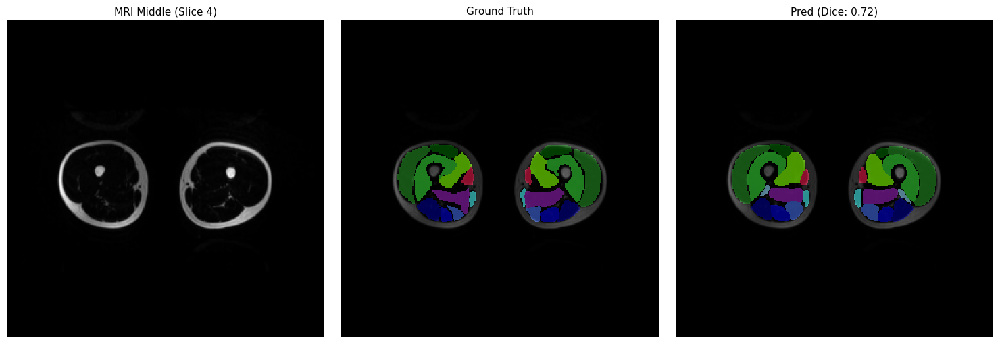

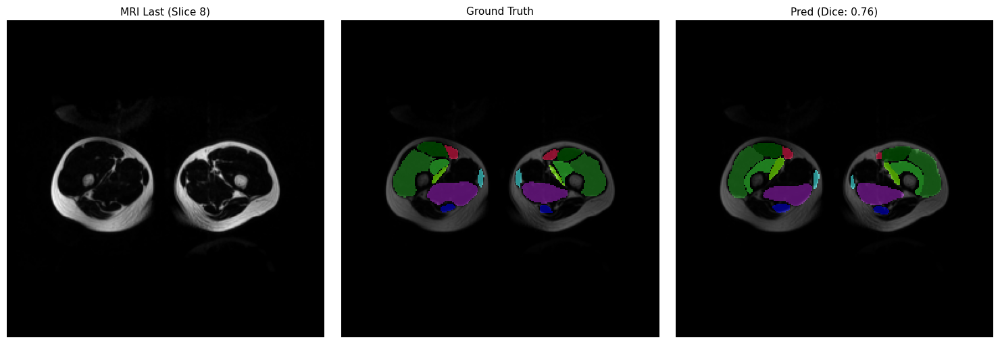


>>> Case: THIGH_011 | Modality: T1


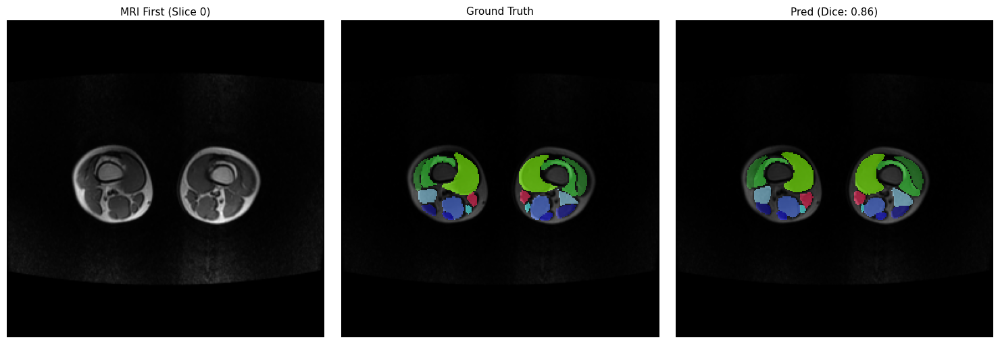

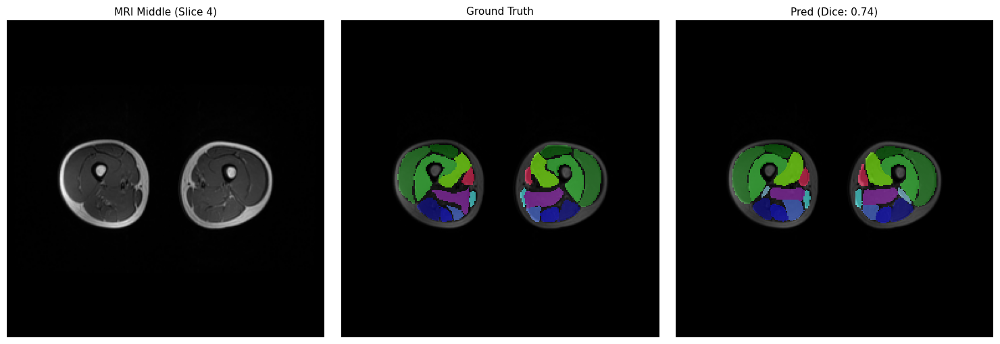

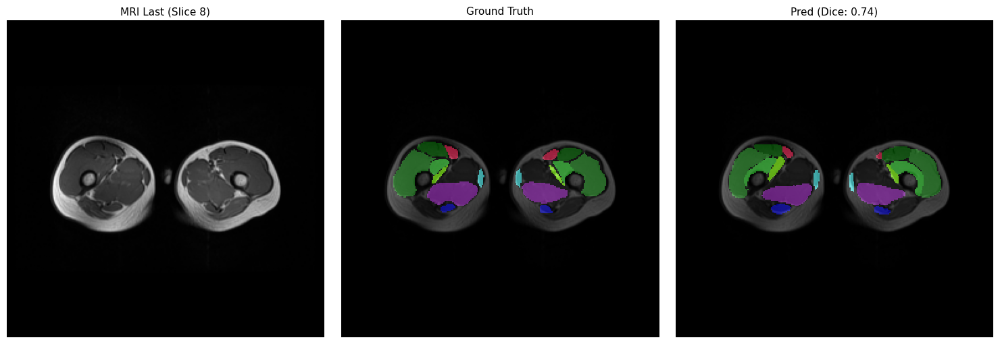


>>> Case: THIGH_011 | Modality: T2


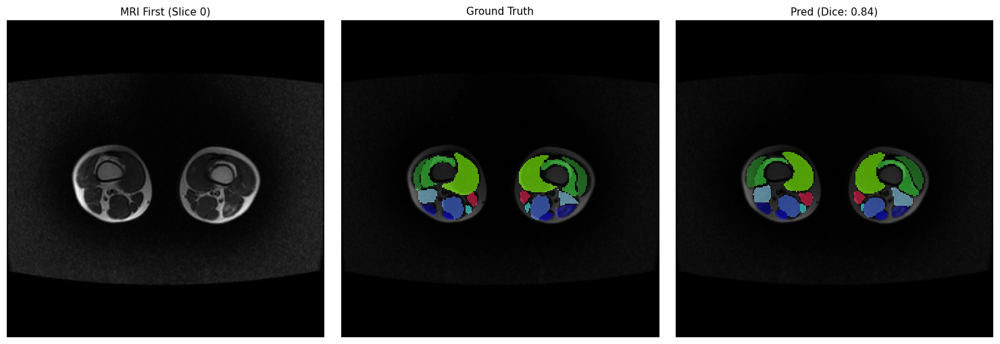

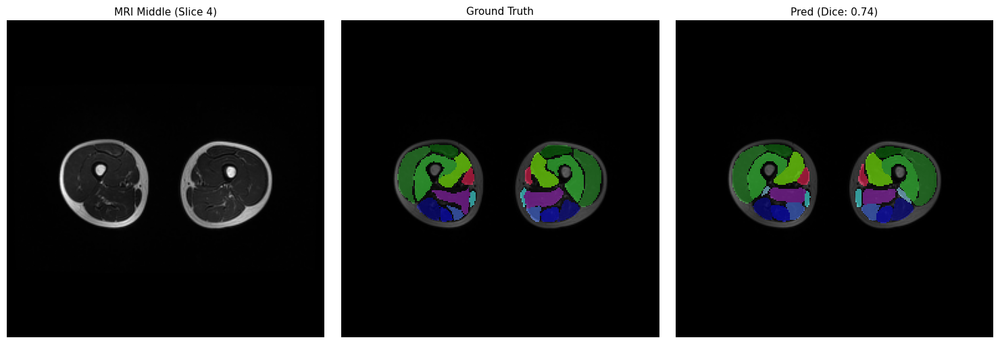

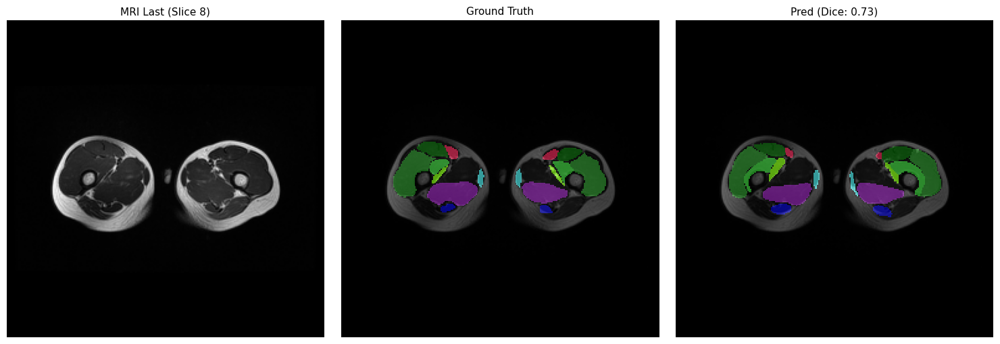


>>> Case: THIGH_011 | Modality: Water


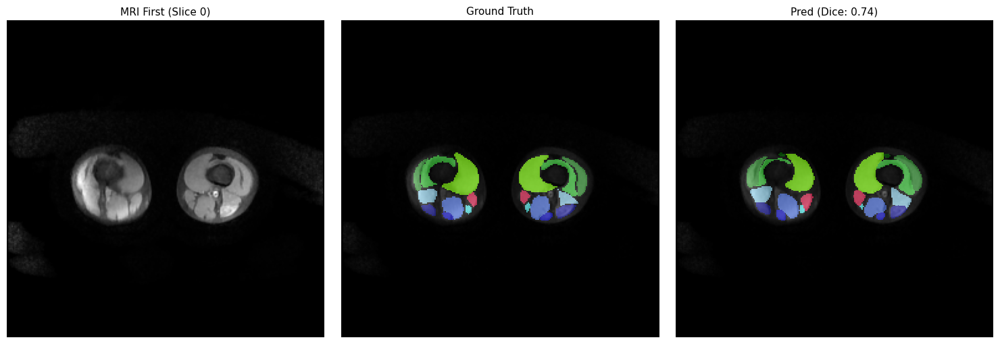

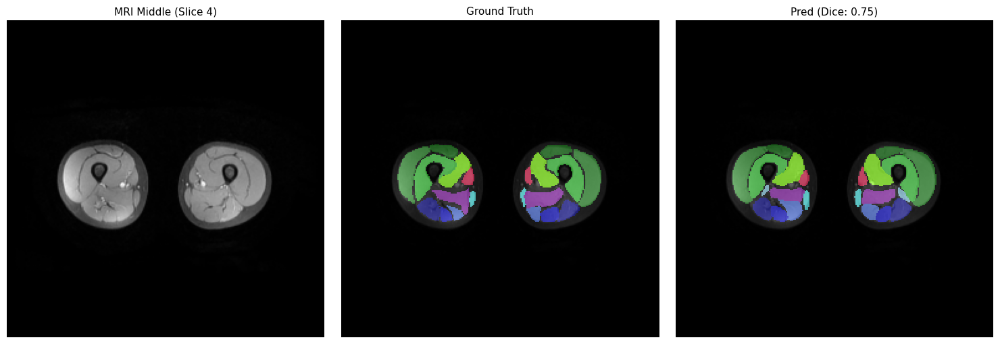

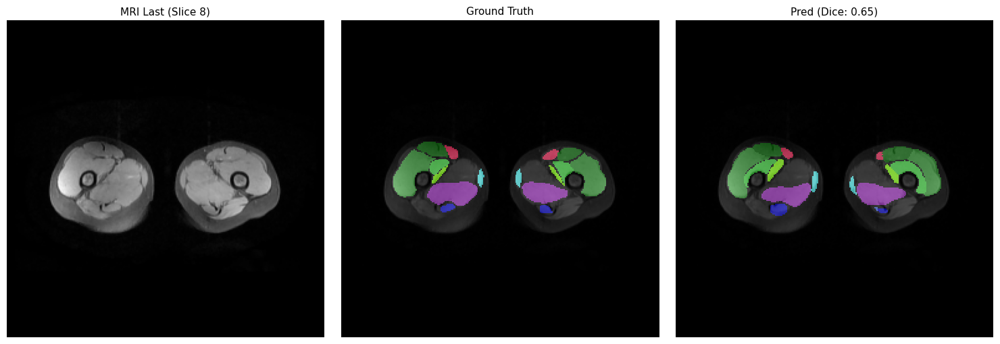


>>> Case: THIGH_019 | Modality: Fat


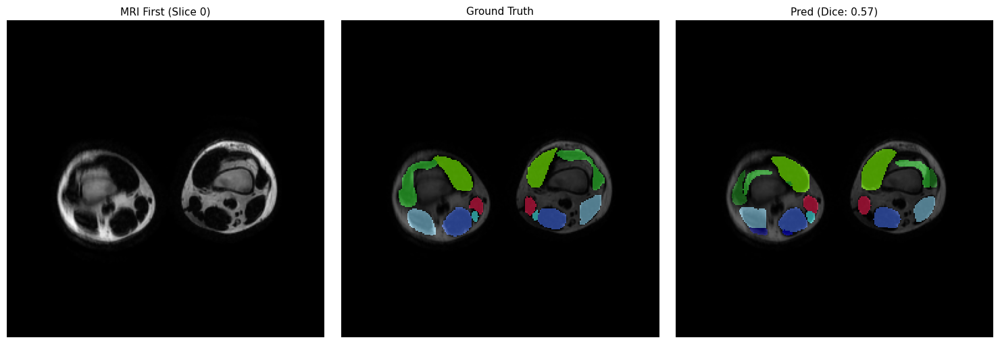

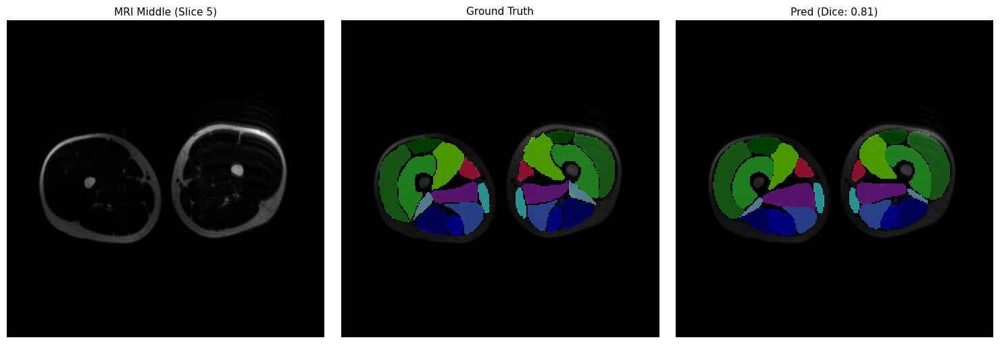

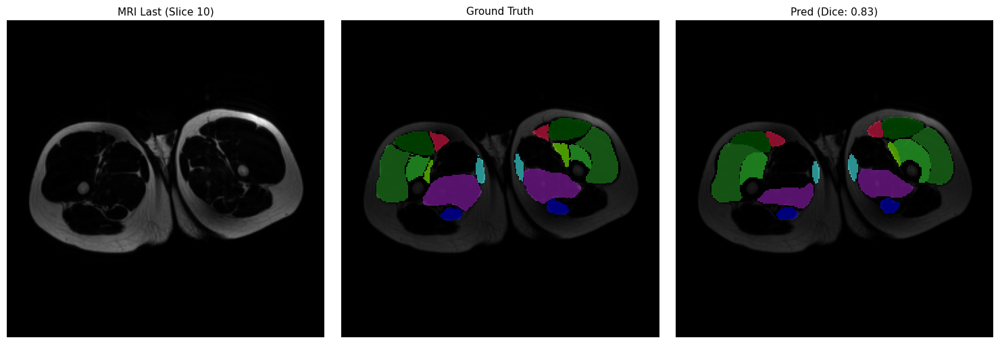


>>> Case: THIGH_019 | Modality: T1


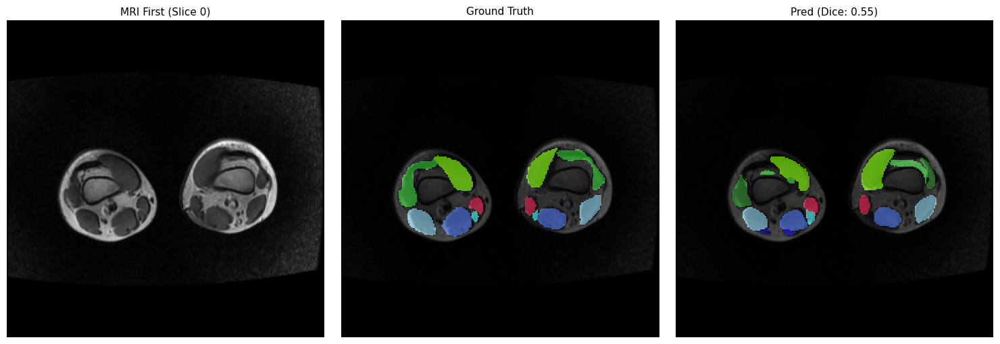

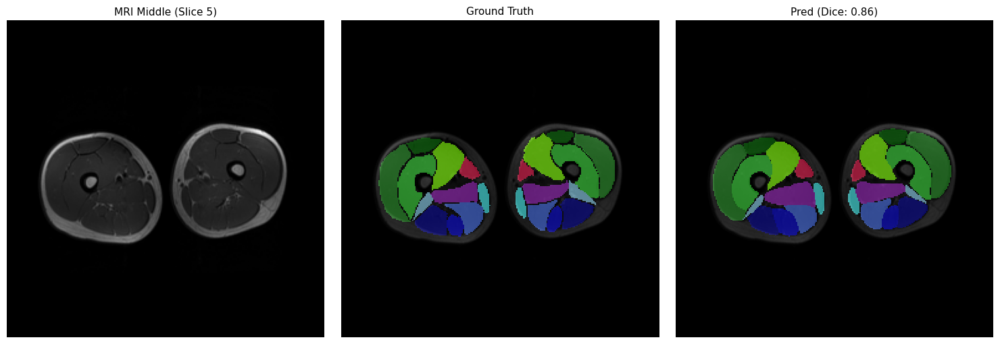

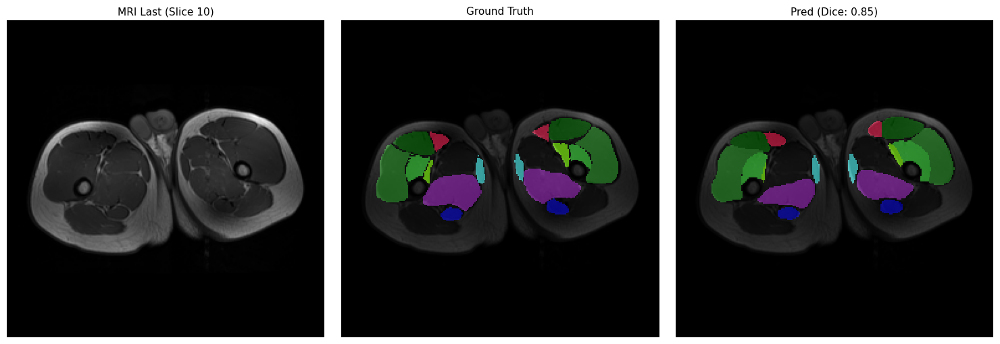


>>> Case: THIGH_019 | Modality: T2


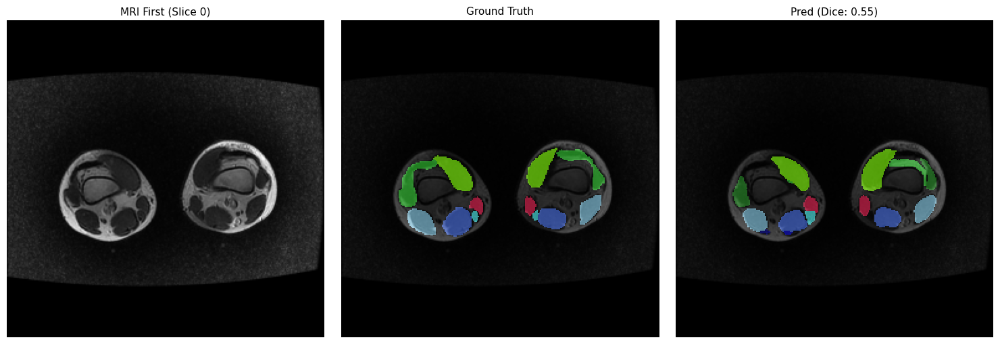

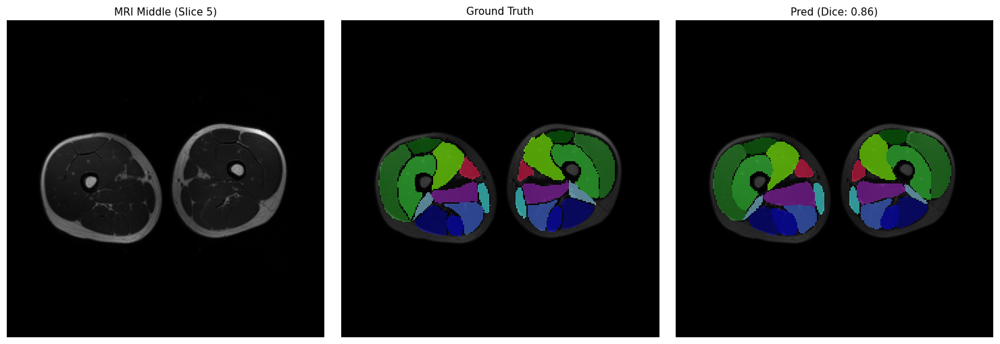

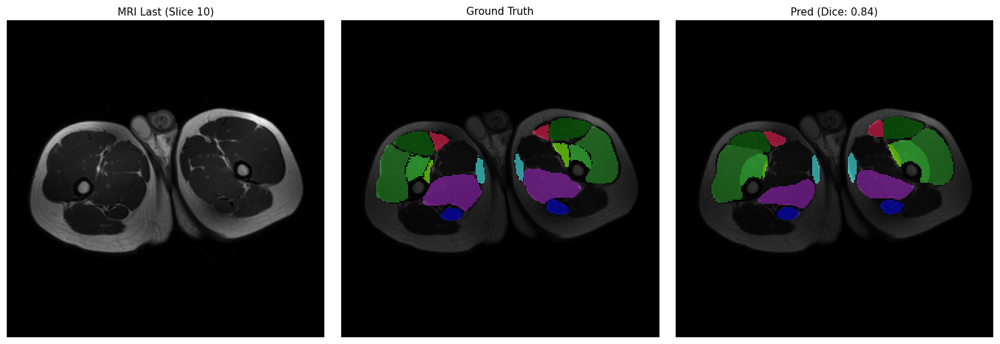


>>> Case: THIGH_019 | Modality: Water


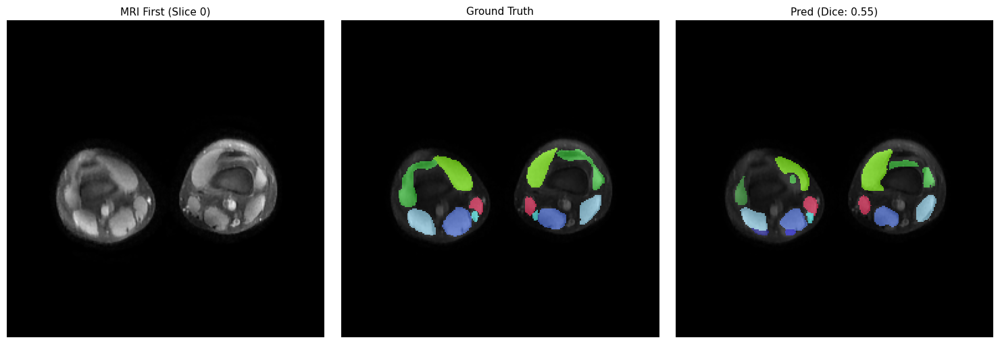

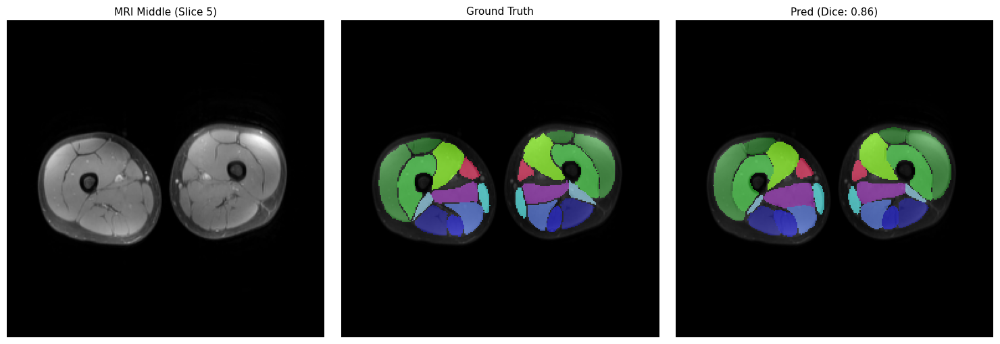

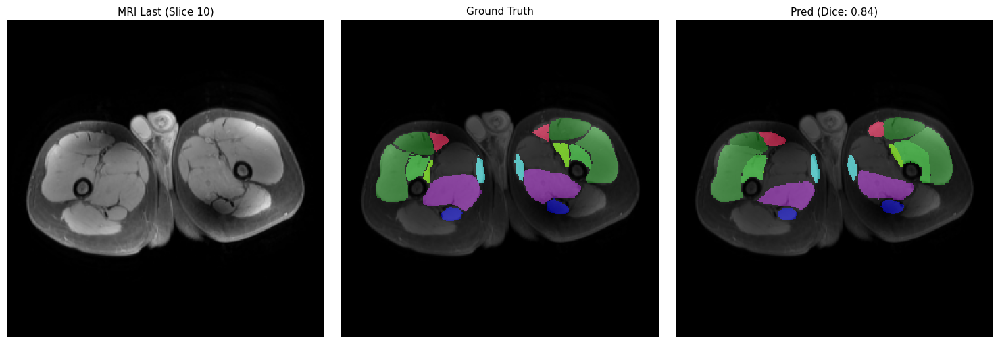


>>> Case: THIGH_027 | Modality: Fat


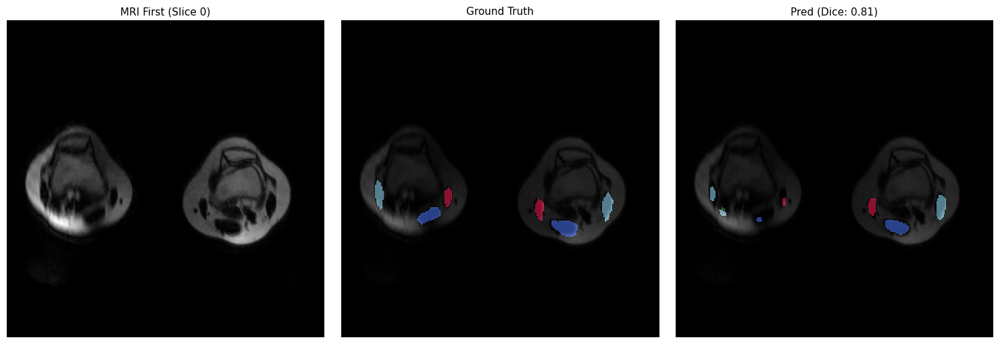

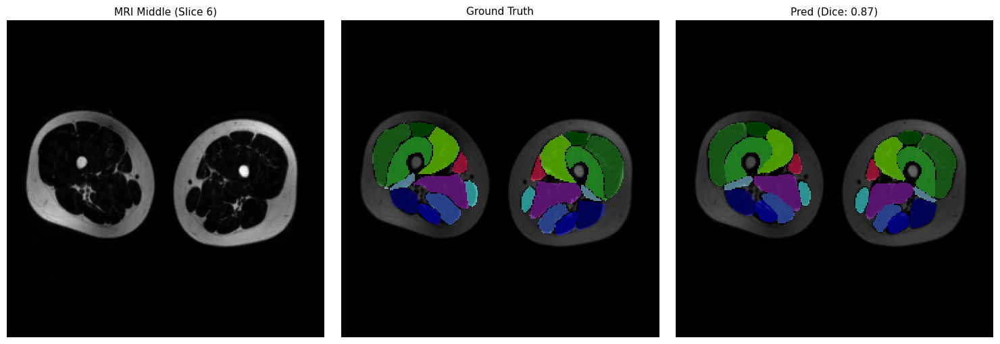

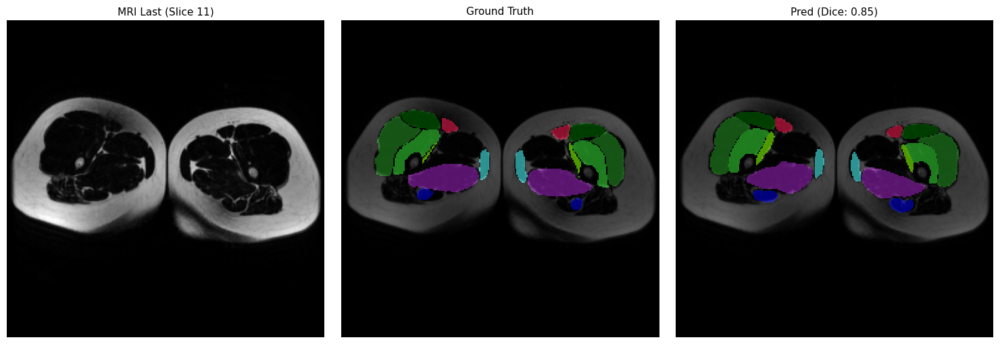


>>> Case: THIGH_027 | Modality: T1


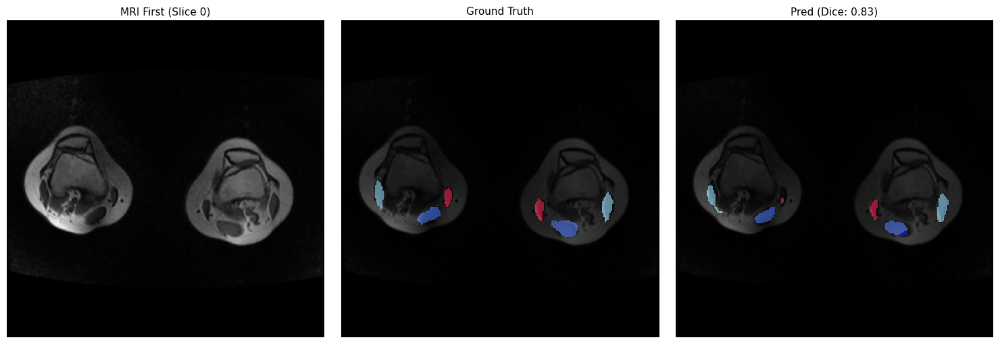

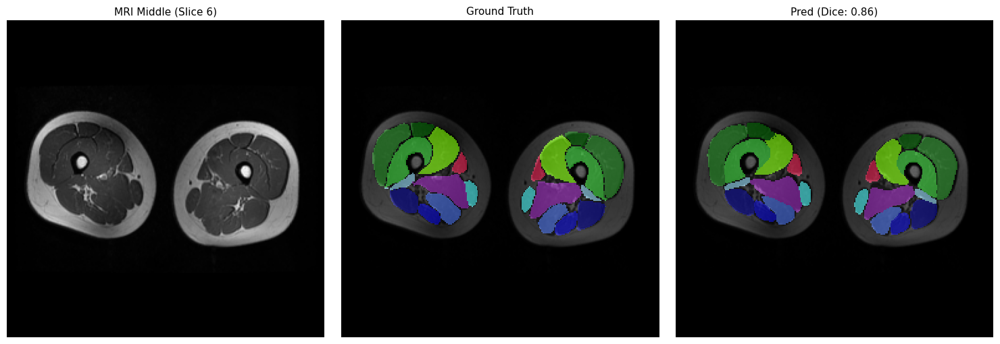

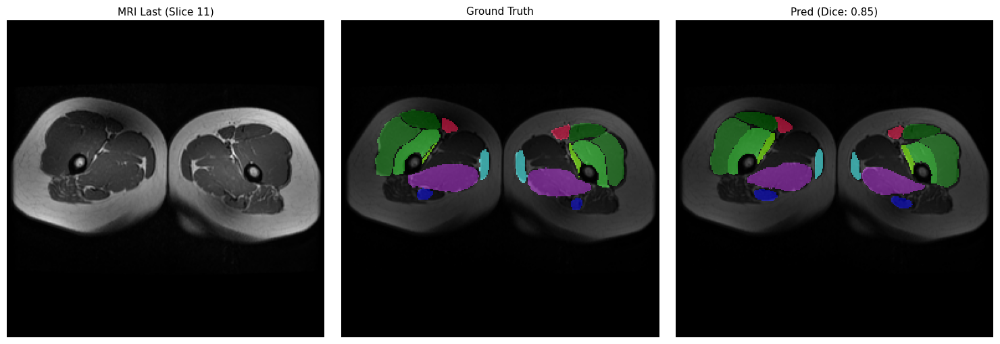


>>> Case: THIGH_027 | Modality: T2


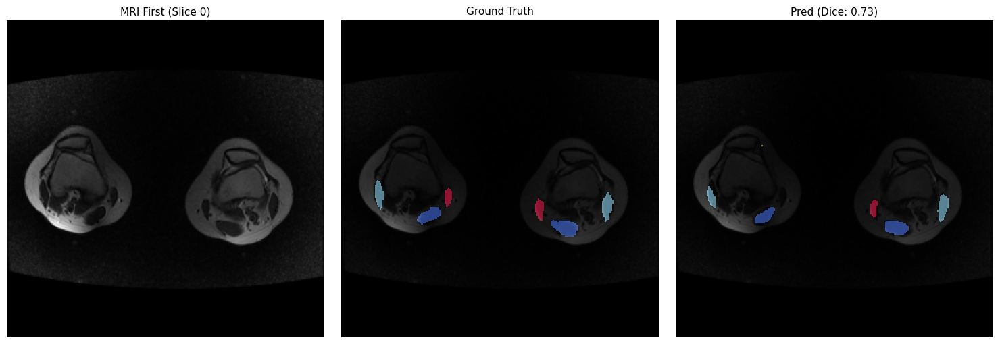

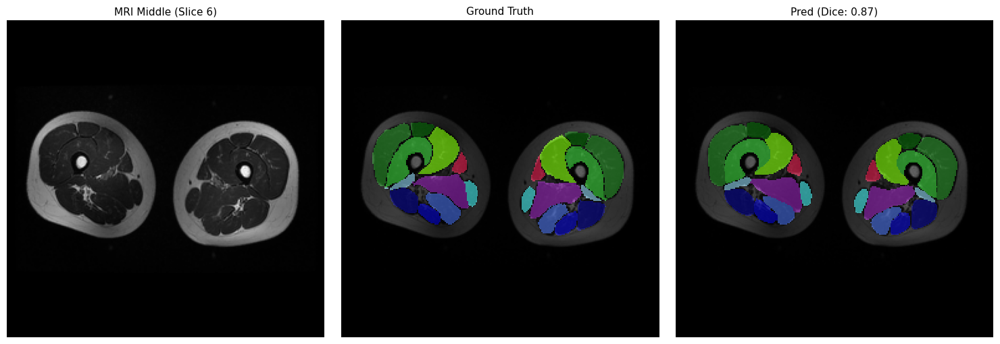

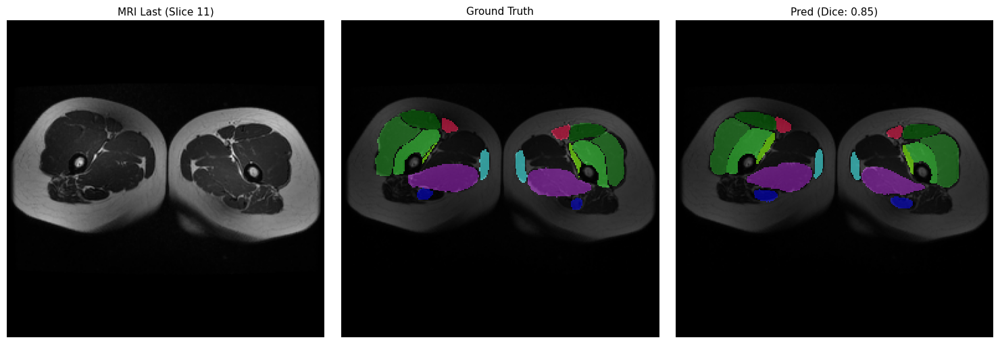


>>> Case: THIGH_027 | Modality: Water


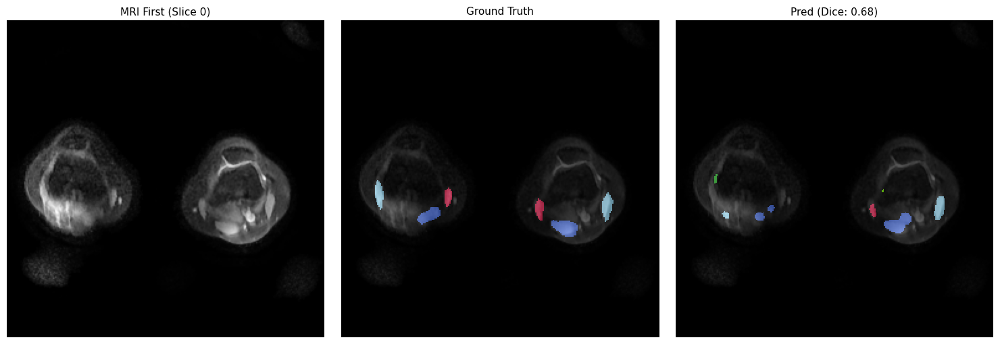

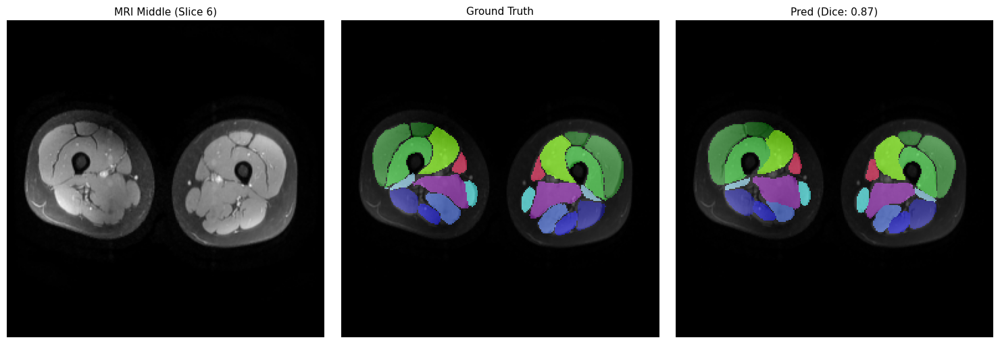

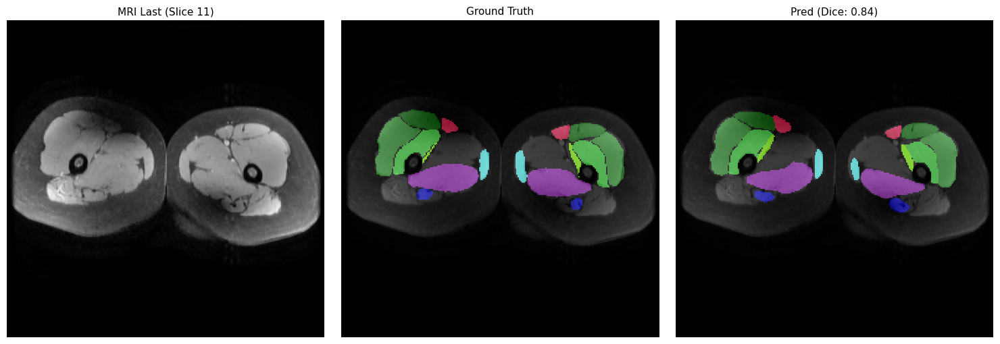


>>> Case: THIGH_046 | Modality: Fat


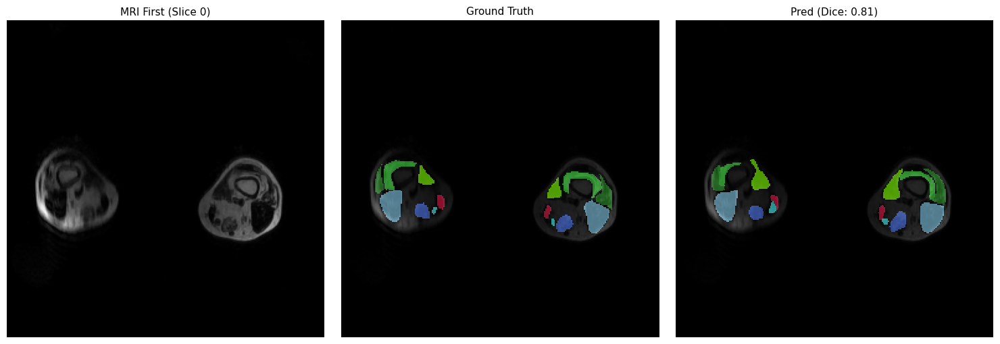

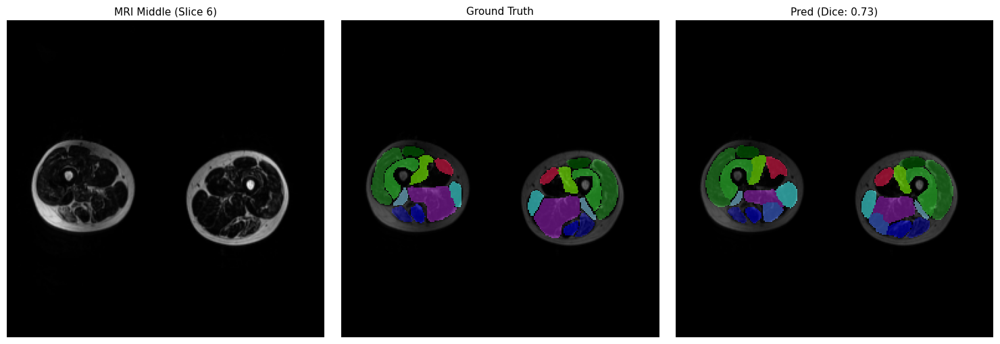

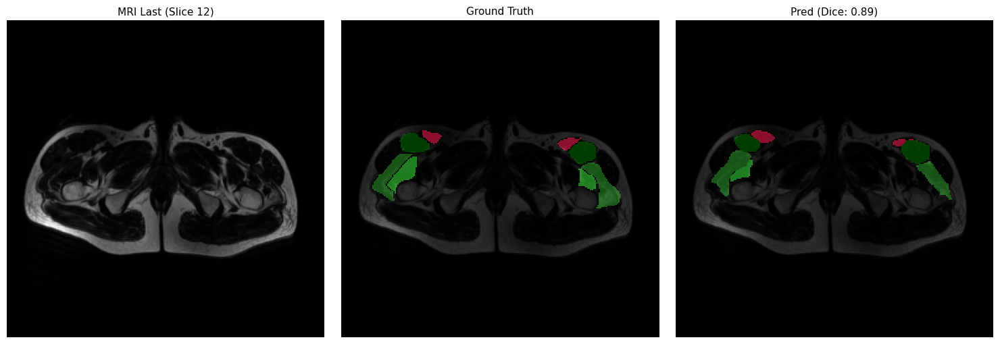


>>> Case: THIGH_046 | Modality: T1


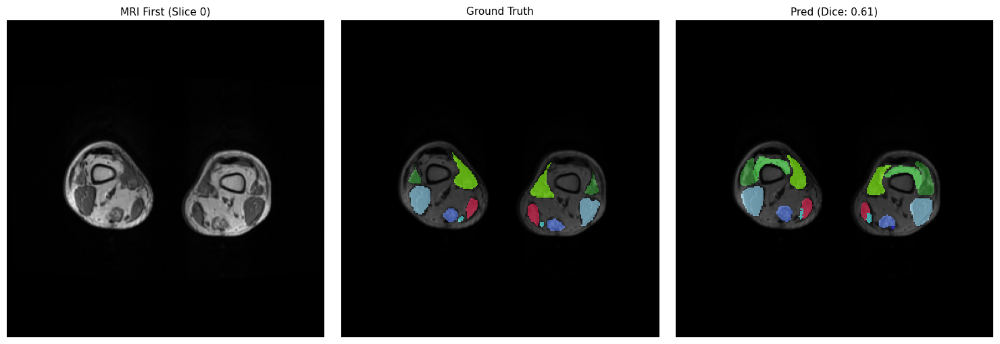

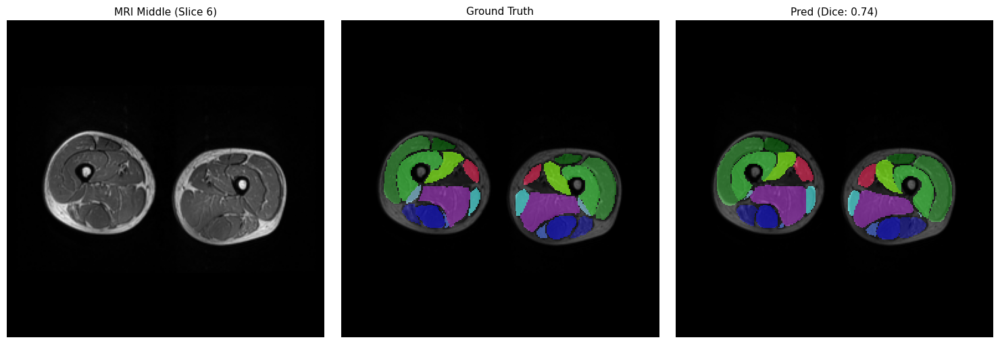

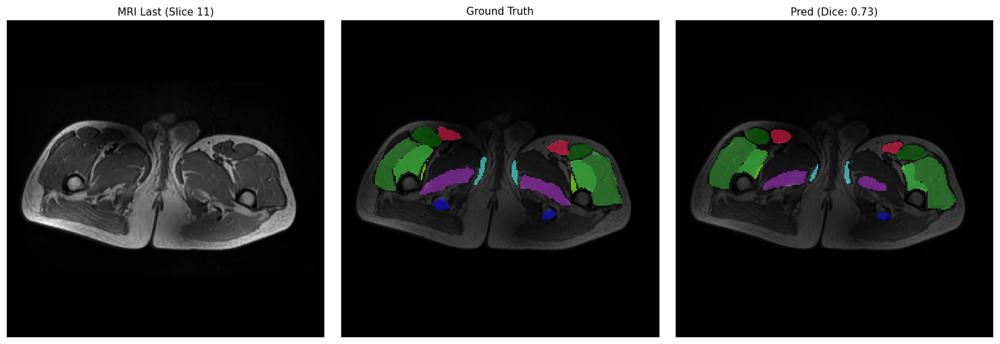


>>> Case: THIGH_046 | Modality: T2


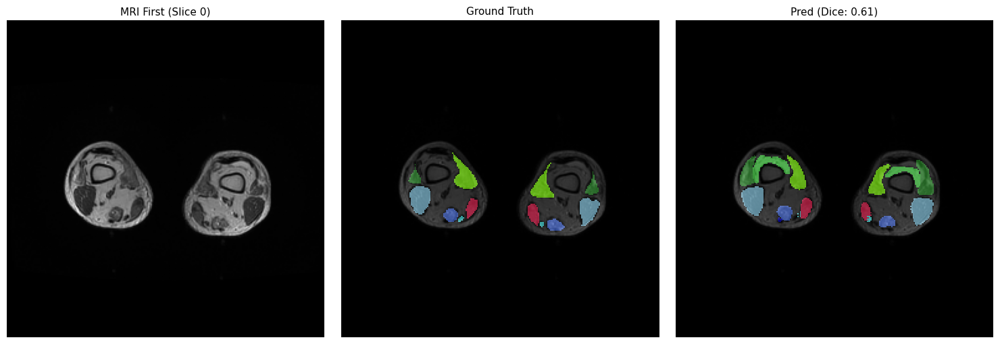

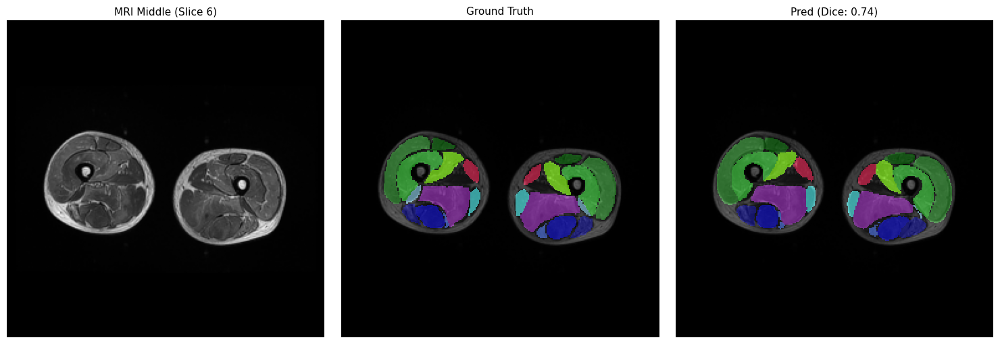

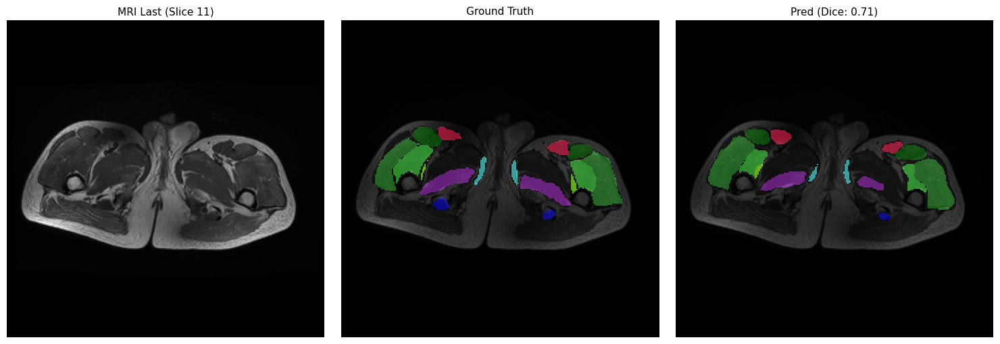


>>> Case: THIGH_046 | Modality: Water


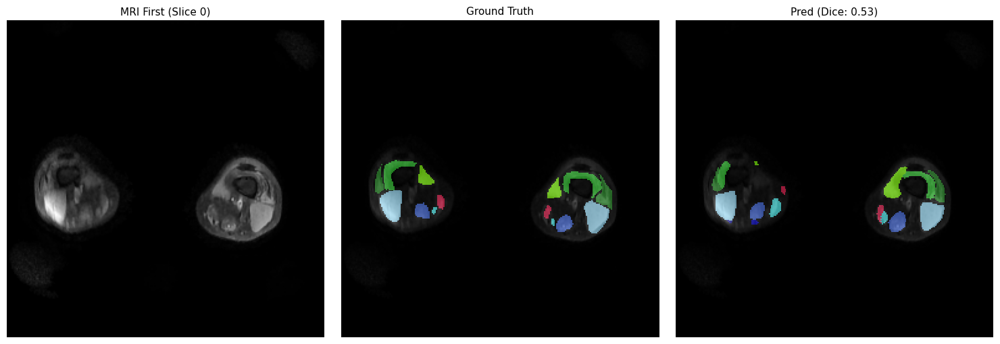

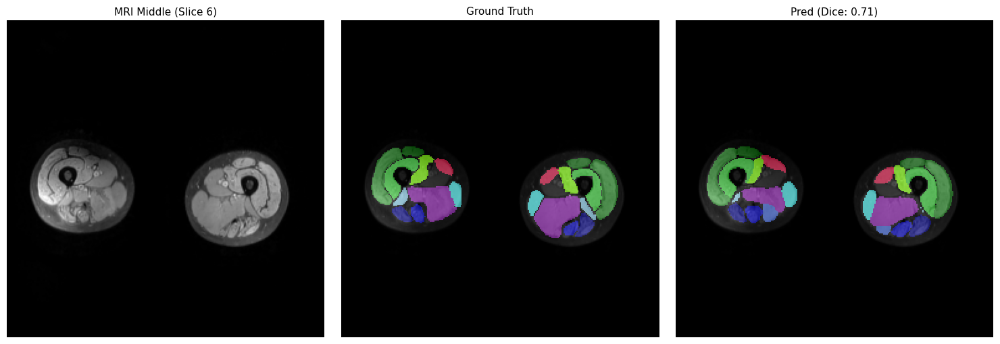

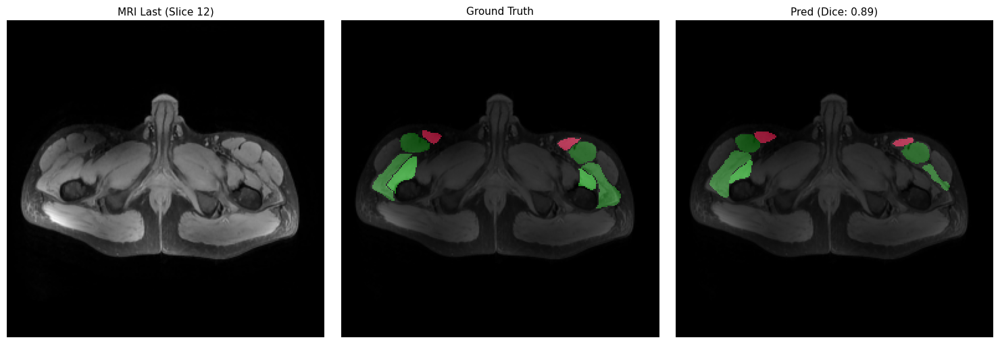


>>> Case: THIGH_057 | Modality: Fat


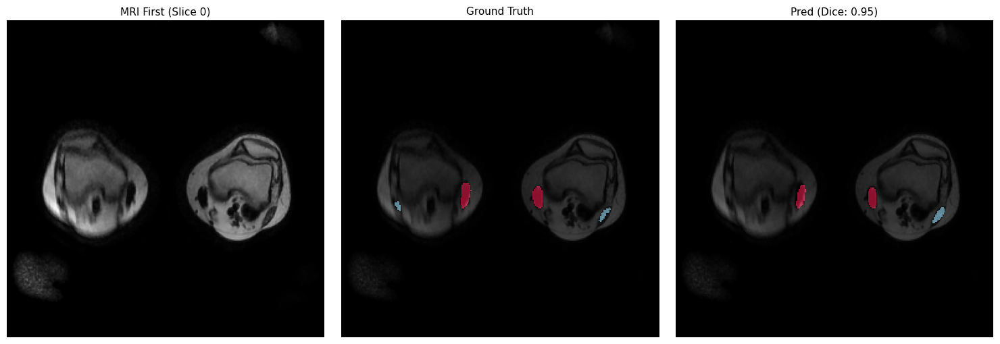

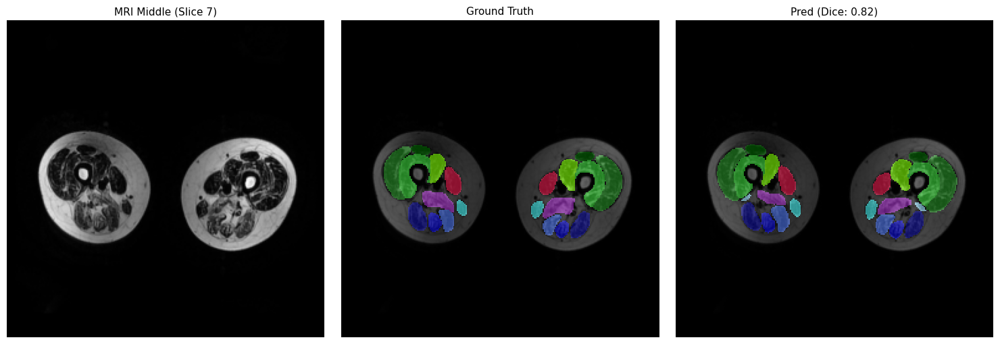

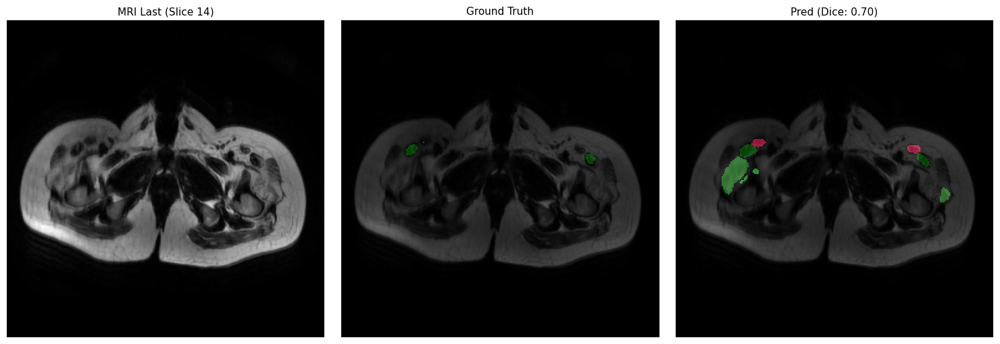


>>> Case: THIGH_057 | Modality: T1


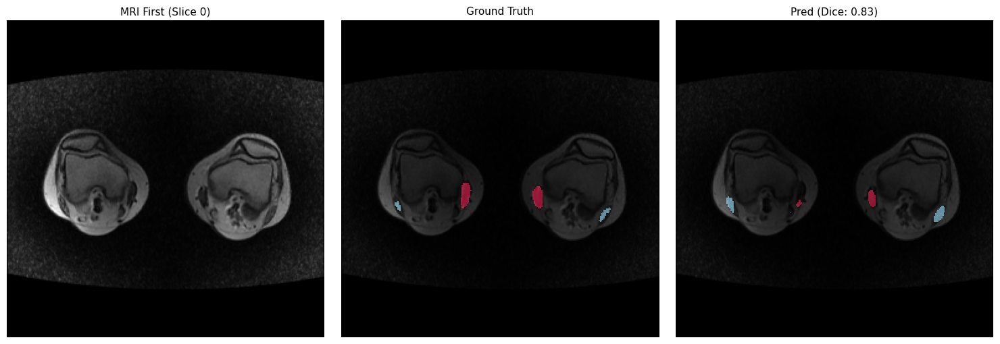

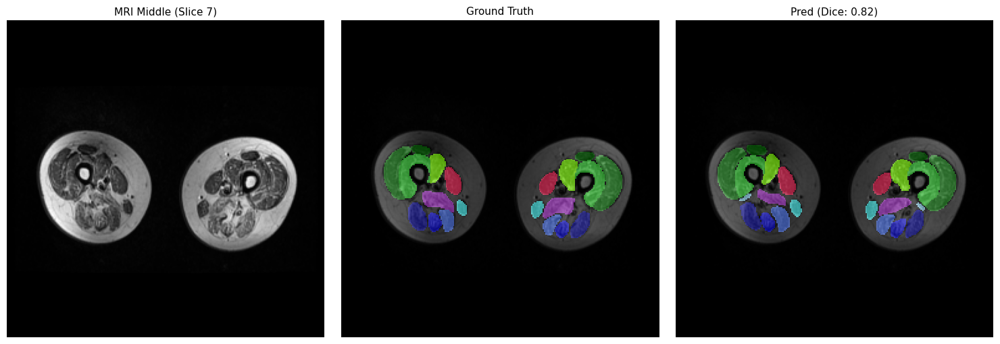

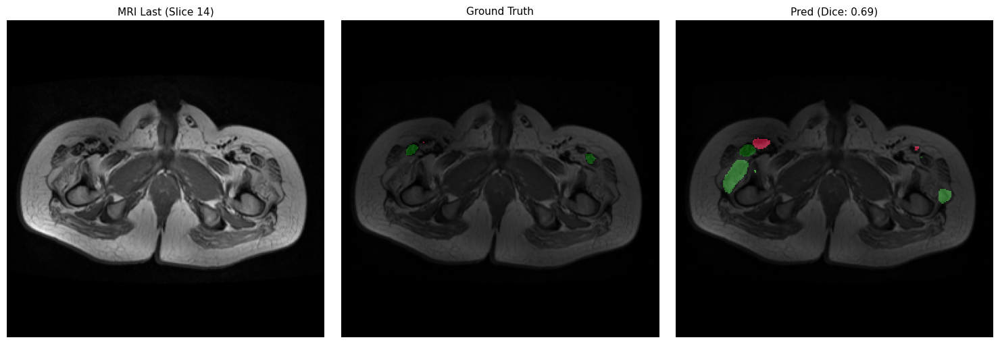


>>> Case: THIGH_057 | Modality: Water


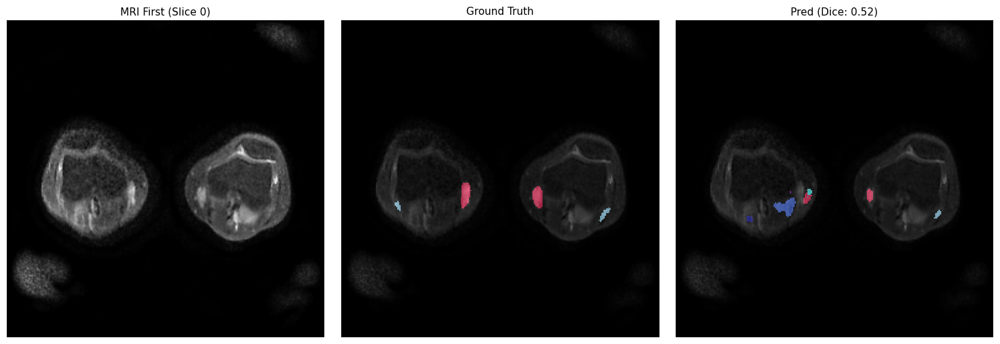

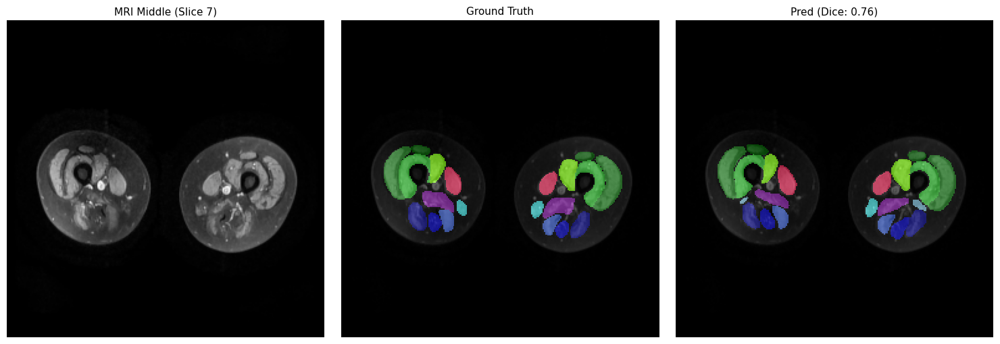

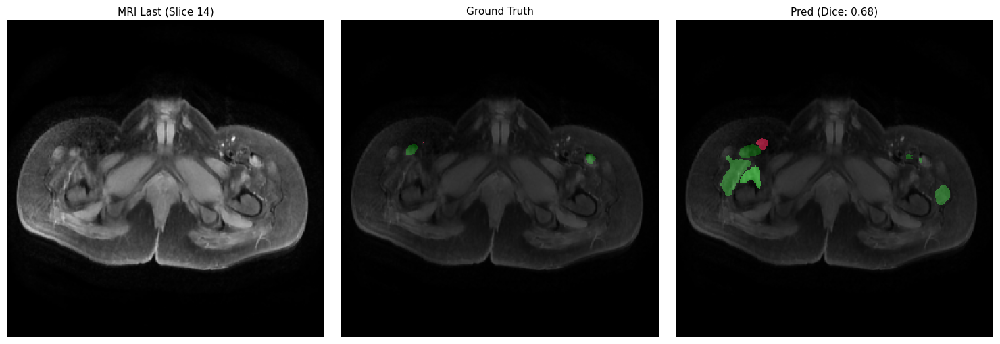


>>> Case: THIGH_104 | Modality: STIR


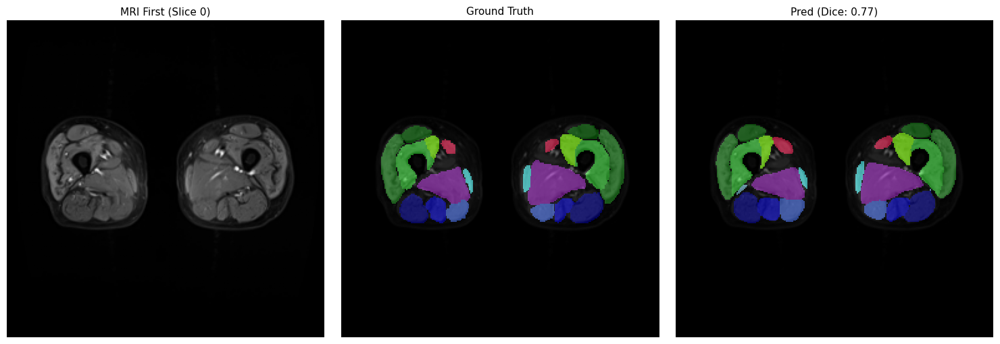

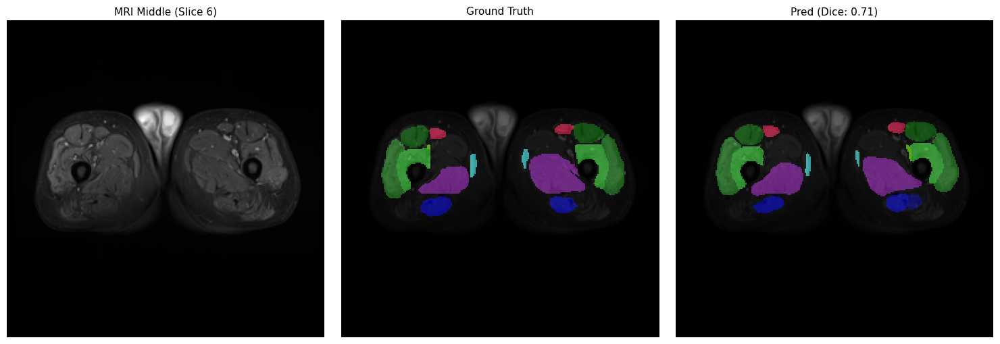

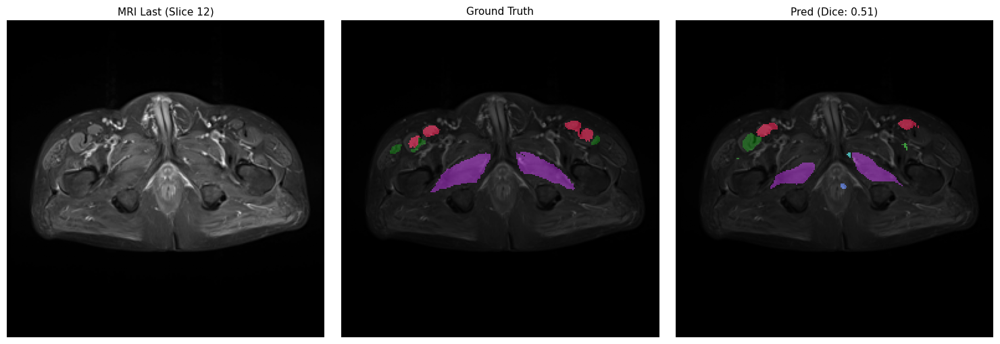


>>> Case: THIGH_104 | Modality: T1


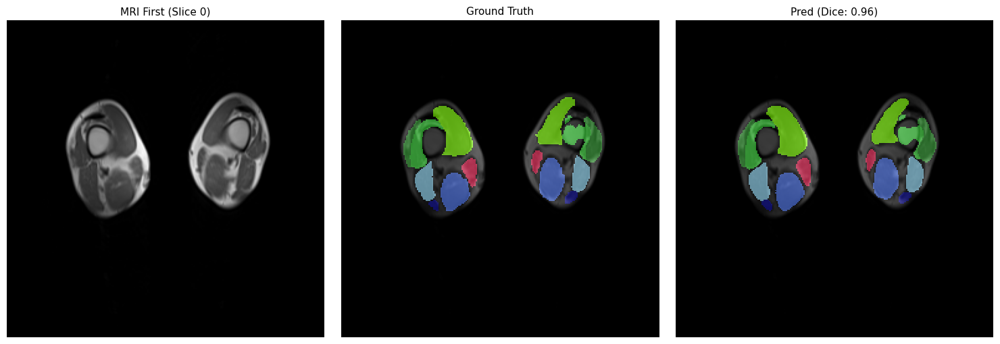

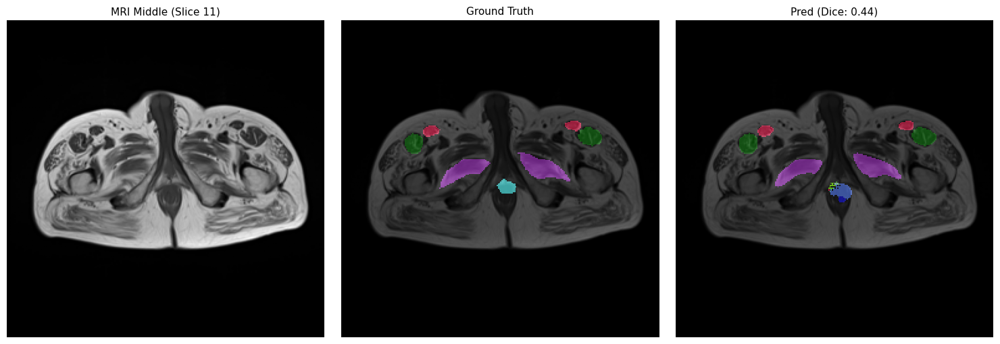

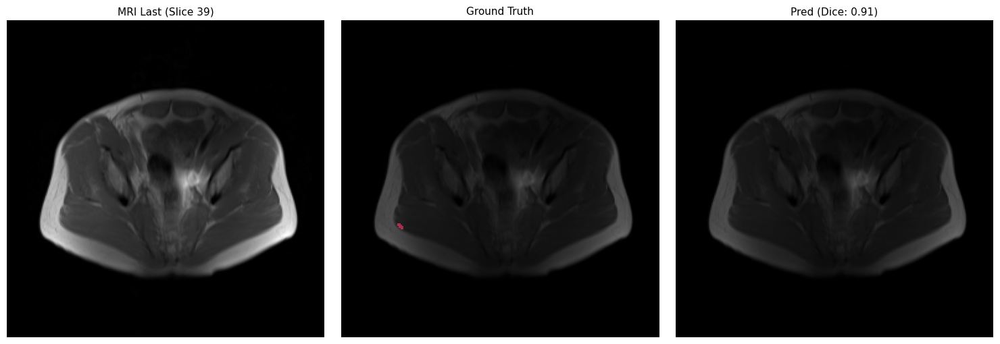


>>> Case: THIGH_108 | Modality: STIR


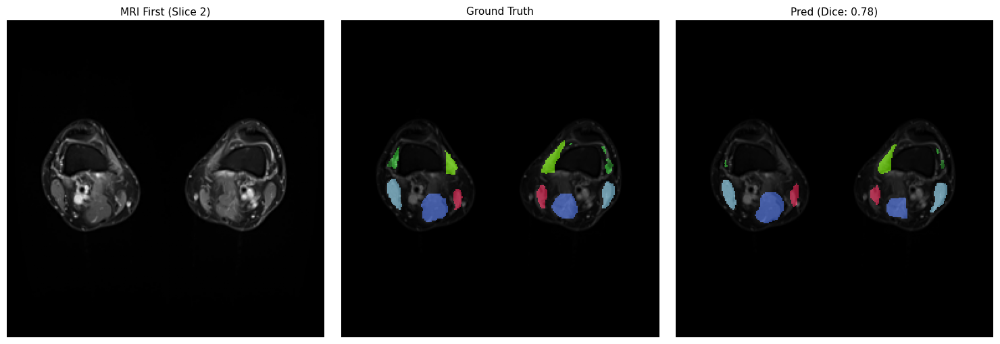

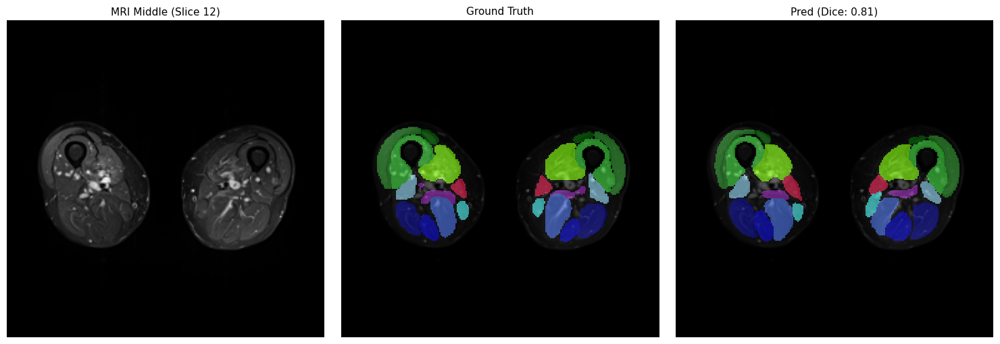

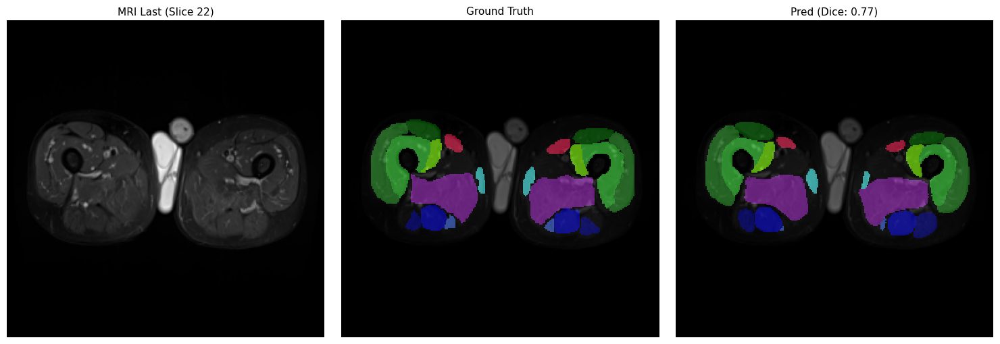


>>> Case: THIGH_108 | Modality: T1


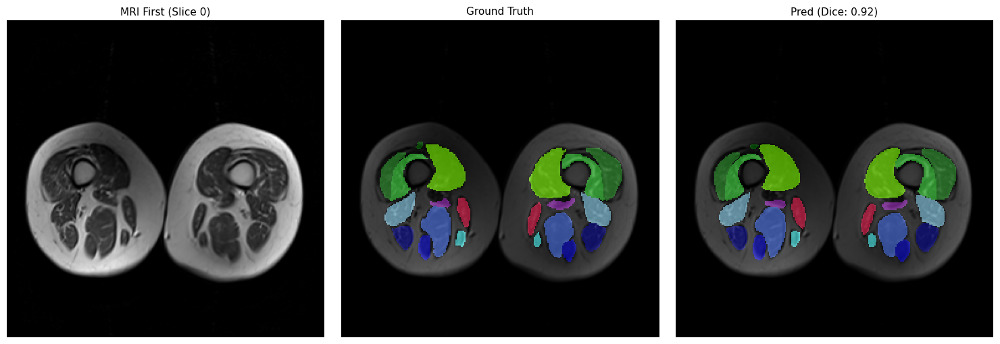

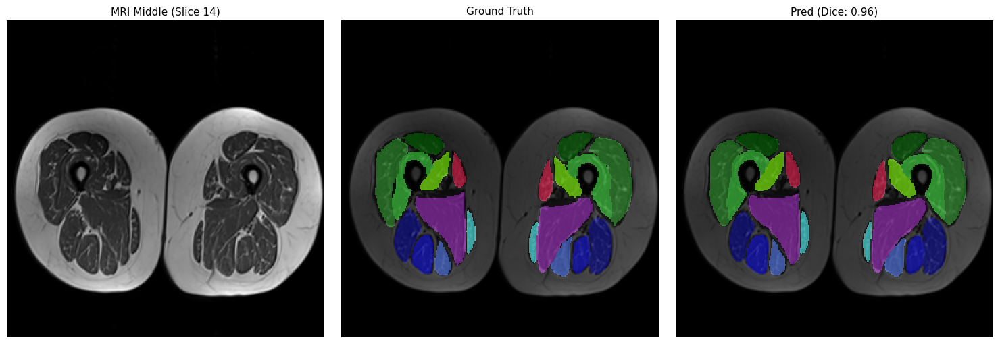

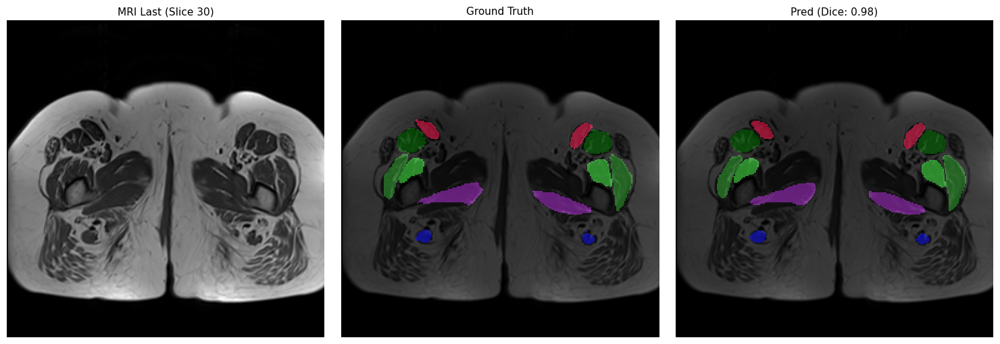


>>> Case: THIGH_118 | Modality: STIR


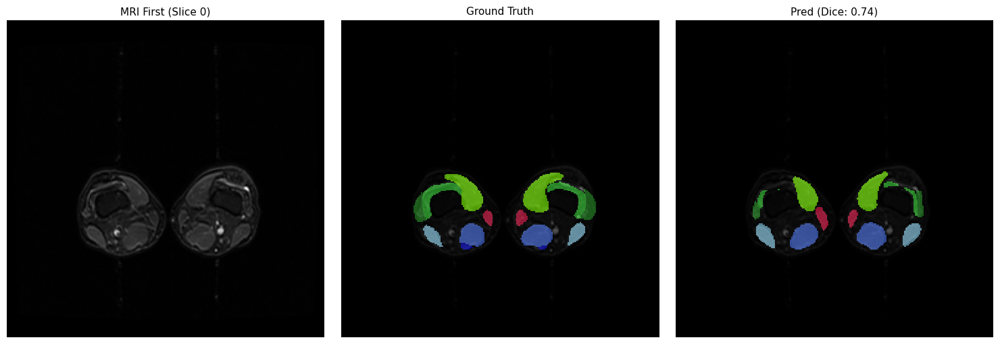

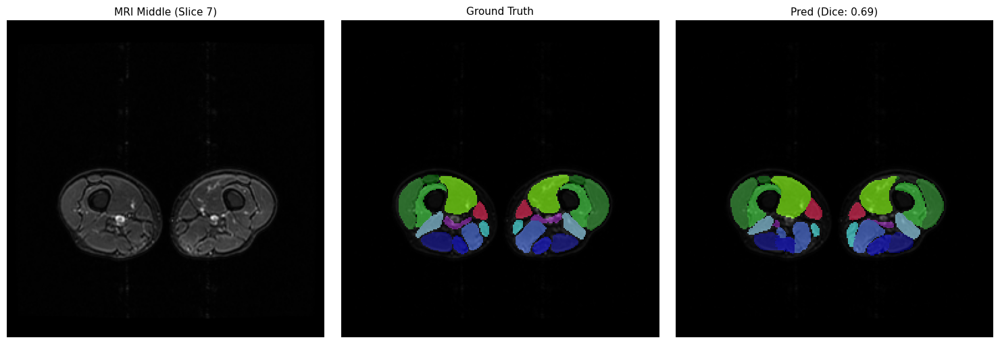

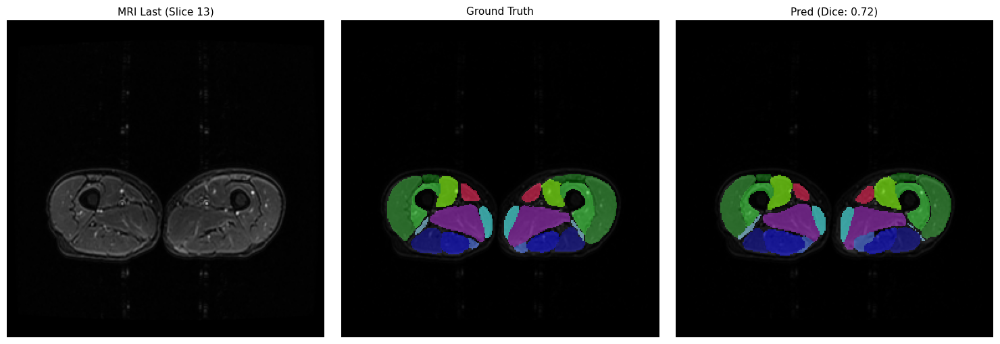


>>> Case: THIGH_118 | Modality: T1


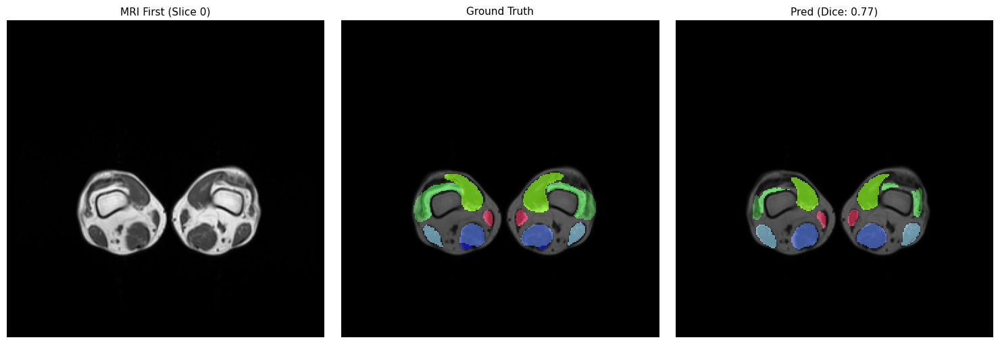

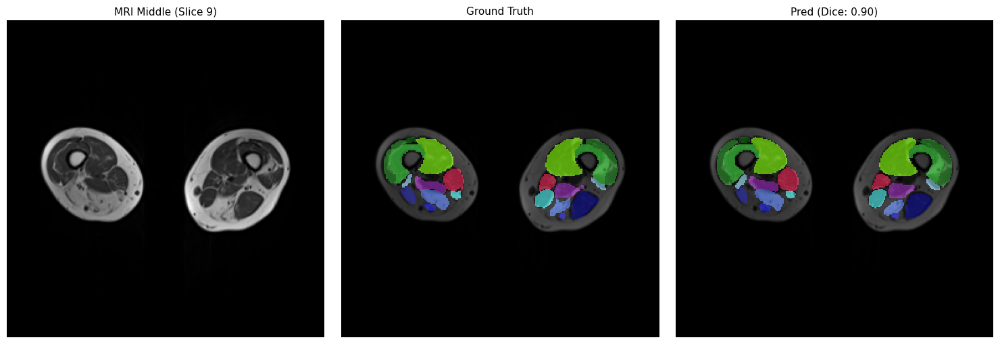

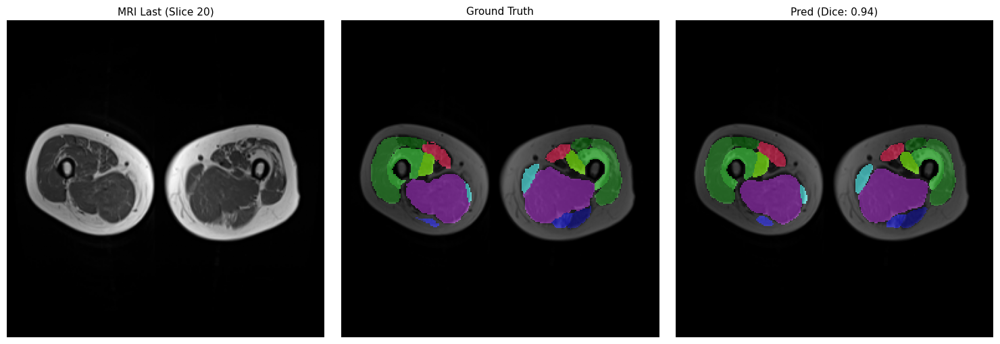


>>> Case: THIGH_119 | Modality: STIR


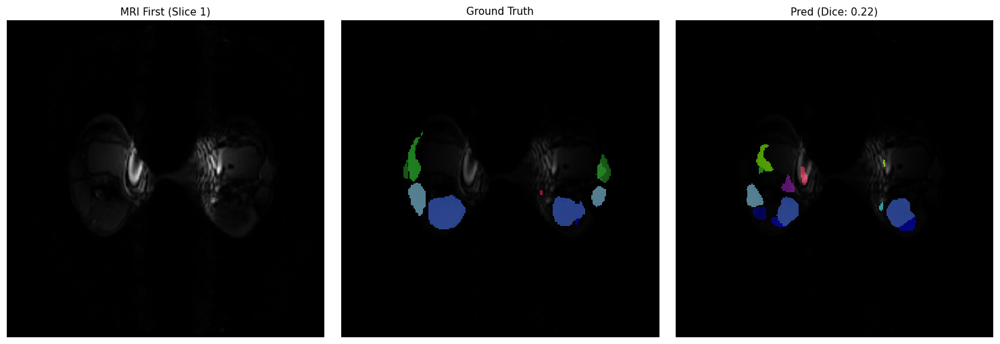

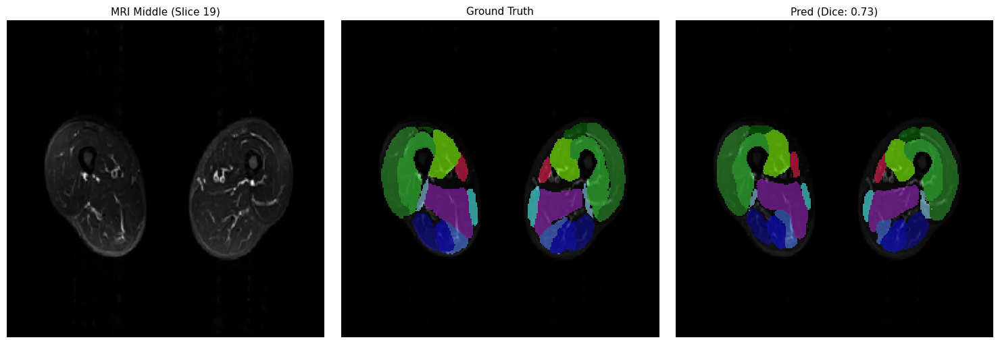

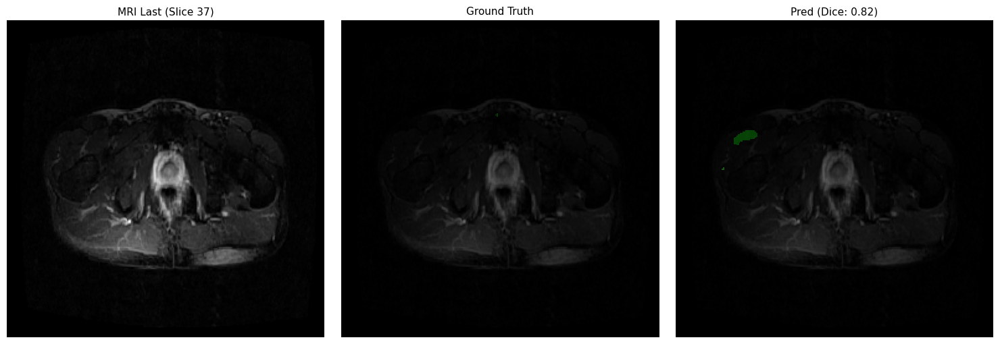


>>> Case: THIGH_119 | Modality: T1


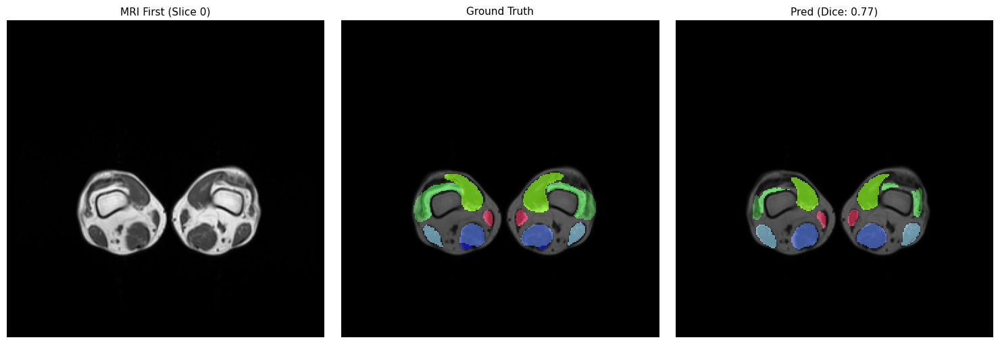

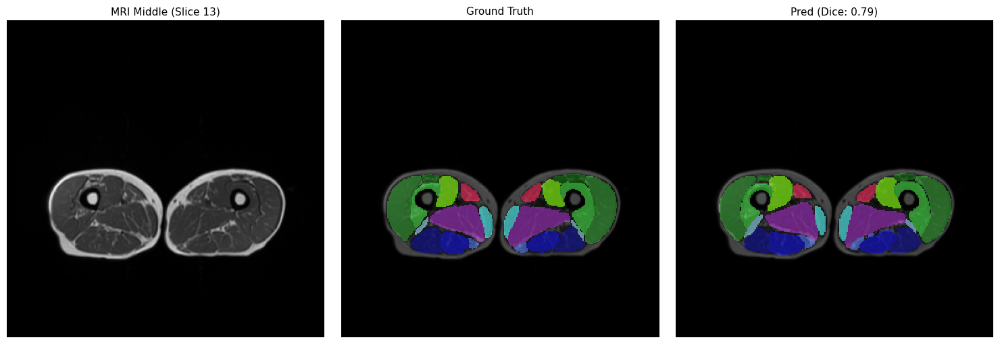

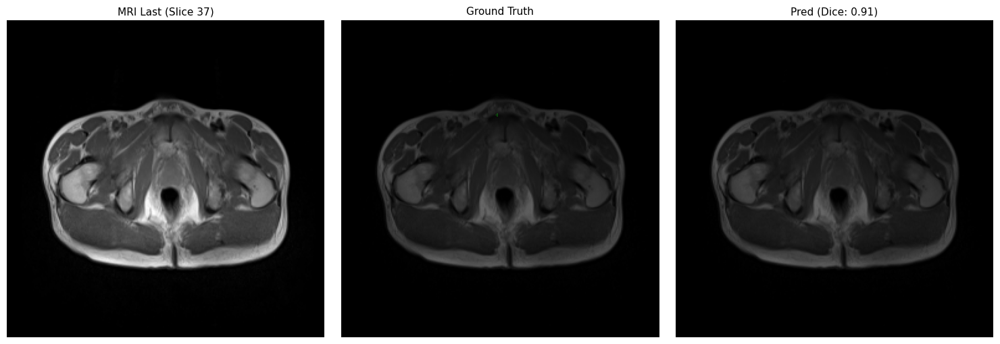

In [9]:
import torch
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
from torch.utils.data import DataLoader
from tqdm import tqdm
from collections import defaultdict

# ================= Configuration =================
BATCH_SIZE = 1 
TARGET_SIZE = (256, 256)
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
MODEL_PATH = os.path.join(root_dir, "best_orthogonal_model.pth")

# 肌肉名稱對照表 (1-11)
MUSCLE_NAMES = {
    1: 'Sartorius',
    2: 'Rectus Femoris',
    3: 'Vastus Lateralis',
    4: 'Vastus Intermedius',
    5: 'Vastus Medialis',
    6: 'Adductor Magnus',
    7: 'Gracilis',
    8: 'Biceps Femoris LH',
    9: 'Semitendinosus',
    10: 'Semimembranosus',
    11: 'Biceps Femoris SH'
}

# 顏色表 (0-11)
colors = [
    '#000000', '#e6194b', '#006400', '#228B22', '#32CD32', '#7CFC00', 
    '#911eb4', '#46f0f0', '#00008B', '#0000CD', '#4169E1', '#87CEEB'
]
cmap = mcolors.ListedColormap(colors)
norm = mcolors.BoundaryNorm(boundaries=np.arange(13)-0.5, ncolors=12)

# ================= 1. 準備資料與鎖定視覺化目標 =================
# 確保 Test Set 依照 Sample -> Sequence -> Slice 排序，這樣才能正確找到頭尾
test_df = metadata_2D_df[metadata_2D_df['split'] == 'test'].copy()
test_detailed_df = test_df[test_df['detailed_label_2D_file'].notna()].copy()

# 依照 Sample, Sequence, Slice 排序
test_detailed_df = test_detailed_df.sort_values(by=['MRI sample', 'MRI Sequence', 'Slice'])

# 重置 index，讓 DataLoader 的順序與之一致
test_detailed_df = test_detailed_df.reset_index(drop=True)

print(f"測試集 (Detailed Only) 數量: {len(test_detailed_df)}")

# --- 鎖定 First, Middle, Last 的 Index ---
viz_indices = set()
# 根據 (Sample, Sequence) 分組
grouped = test_detailed_df.groupby(['MRI sample', 'MRI Sequence'])

for name, group in grouped:
    indices = group.index.tolist()
    if not indices: continue
    
    # 挑選頭、中、尾
    first_idx = indices[0]
    mid_idx = indices[len(indices)//2]
    last_idx = indices[-1]
    
    viz_indices.add(first_idx)
    viz_indices.add(mid_idx)
    viz_indices.add(last_idx)

print(f"預計視覺化切片數: {len(viz_indices)} (包含每個個案/序列的頭中尾)")

# 建立 Dataset 與 Loader
test_ds = MuscleTwoHeadDataset(test_detailed_df, root_dir, target_size=TARGET_SIZE)
# shuffle=False 非常重要，這樣 Loader 的順序才會跟 dataframe index 對上
test_loader = DataLoader(test_ds, batch_size=1, shuffle=False, num_workers=2)

# ================= 2. 載入模型 =================
model = TwoHeadUNet(n_channels=1, 
                    n_classes_detailed=NUM_CLASSES_DETAILED, 
                    n_classes_rough=NUM_CLASSES_ROUGH)
model.load_state_dict(torch.load(MODEL_PATH, map_location=DEVICE))
model.to(DEVICE)
model.eval()

# ================= 3. 推論與數據收集 =================
# 儲存結構: metrics[Sequence][Muscle_ID] = [dice1, dice2, ...]
metrics_data = defaultdict(lambda: defaultdict(list))
viz_results = [] # 儲存要畫圖的資料

with torch.no_grad():
    # 使用 enumerate 取得目前的 index (對應 dataframe index)
    for idx, (images, labels, types, sample_ids) in enumerate(tqdm(test_loader)):
        images, labels = images.to(DEVICE), labels.to(DEVICE)
        
        # 取得 meta info
        row = test_detailed_df.iloc[idx]
        seq = row['MRI Sequence']
        sample_id = row['MRI sample']
        slice_num = row['Slice']
        
        # 推論
        out_det, _ = model(images)
        pred_det = torch.argmax(out_det, dim=1)
        
        # --- 計算每個肌肉的 Dice 並存起來 ---
        for c in range(1, NUM_CLASSES_DETAILED):
            pred_mask = (pred_det == c)
            true_mask = (labels == c)
            
            inter = (pred_mask & true_mask).sum().item()
            union = (pred_mask.sum() + true_mask.sum()).item()
            
            dice_val = 1.0 # Default (True Negative)
            if union > 0:
                dice_val = 2 * inter / union
            
            # 存入對應 Sequence 的對應肌肉列表
            metrics_data[seq][c].append(dice_val)
            
        # --- 判斷是否為視覺化目標 ---
        if idx in viz_indices:
            # 計算該張圖的平均 Dice (用來顯示在標題)
            valid_dices = [metrics_data[seq][c][-1] for c in range(1, NUM_CLASSES_DETAILED)]
            avg_dice = sum(valid_dices) / len(valid_dices)
            
            viz_results.append({
                'sample': sample_id,
                'seq': seq,
                'slice': slice_num,
                'img': images[0, 0].cpu().numpy(),
                'gt': labels[0].cpu().numpy(),
                'pred': pred_det[0].cpu().numpy(),
                'dice': avg_dice,
                # 標記位置 (First/Mid/Last 供顯示用)
                'pos': 'First' if idx == grouped.get_group((sample_id, seq)).index[0] else \
                       ('Last' if idx == grouped.get_group((sample_id, seq)).index[-1] else 'Middle')
            })

# ================= 4. 產生報表 =================
print("\n" + "="*40)
print("   各 MRI Sequence 分肌肉 Dice 評估表")
print("="*40)

# 整理成 DataFrame
# Rows: Muscle Names, Cols: Sequences
final_table = {}
all_sequences = sorted(metrics_data.keys())

for c in range(1, NUM_CLASSES_DETAILED):
    muscle_name = MUSCLE_NAMES[c]
    row_data = {}
    for seq in all_sequences:
        dices = metrics_data[seq][c]
        mean_dice = np.mean(dices) if dices else 0.0
        row_data[seq] = mean_dice
    final_table[muscle_name] = row_data

df_metrics = pd.DataFrame(final_table).T # 轉置: Muscle 為 Index
df_metrics = df_metrics.sort_index()

# 加入整體平均 (Total Mean per Sequence)
df_metrics.loc['AVERAGE'] = df_metrics.mean()

# 顯示漂亮的表格
pd.options.display.float_format = '{:.4f}'.format
print("數值為 Mean Dice Score:")
display(df_metrics)

# 也可以存成 CSV
df_metrics.to_csv(os.path.join(root_dir, "evaluation_metrics_per_sequence.csv"))
print(f"\n評估表已儲存至 evaluation_metrics_per_sequence.csv")


# ================= 5. 視覺化展示 =================
print("\n" + "="*40)
print("   個案切片視覺化 (First / Middle / Last)")
print("="*40)

current_sample = ""
current_seq = ""

for item in viz_results:
    # 當換一個 Sample 或 Sequence 時印出標題
    if item['sample'] != current_sample or item['seq'] != current_seq:
        print(f"\n>>> Case: {item['sample']} | Modality: {item['seq']}")
        current_sample = item['sample']
        current_seq = item['seq']
    
    fig, axs = plt.subplots(1, 3, figsize=(15, 5))
    
    # 標題包含位置 (First/Mid/Last) 和 Slice Index
    pos_str = f"{item['pos']} (Slice {item['slice']})"
    
    axs[0].imshow(item['img'], cmap='gray')
    axs[0].set_title(f"MRI {pos_str}", fontsize=11)
    axs[0].axis('off')
    
    axs[1].imshow(item['img'], cmap='gray')
    axs[1].imshow(item['gt'], cmap=cmap, norm=norm, alpha=0.6, interpolation='nearest')
    axs[1].set_title("Ground Truth", fontsize=11)
    axs[1].axis('off')
    
    axs[2].imshow(item['img'], cmap='gray')
    axs[2].imshow(item['pred'], cmap=cmap, norm=norm, alpha=0.6, interpolation='nearest')
    axs[2].set_title(f"Pred (Dice: {item['dice']:.2f})", fontsize=11)
    axs[2].axis('off')
    
    plt.tight_layout()
    plt.show()

In [ ]:
import pandas as pd
import os 

df_metrics = pd.read_csv(os.path.join(root_dir, "evaluation_metrics_per_sequence.csv", index_col=0)

print(df_metrics.index)

avg_row = df_metrics.loc[['AVERAGE']]

other_rows = df_metrics.drop('AVERAGE')

df_metrics = pd.concat([avg_row, other_rows])

flat = df_metrics.stack()  # 變成 MultiIndex Series (row, col)
flat.index = [f"{row}_{col}" for row, col in flat.index]  # 合併名稱
flat_df = flat.to_frame().T  # 轉成一列 DataFrame

flat_df.to_csv("flattened_metrics.csv", index=False)